<a href="https://colab.research.google.com/github/hvkchaitanya7/grp3capstone-final/blob/main/ImageCaptiongenerator_Transformer_Resnet50.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
#from google.colab import drive
#drive.mount('/content/gdrive')

# New Section

To download Flickr Data set and unzip it . It has 8000 images and we will be using 5000 for training , 1000 validation and 2000 for testing 

In [ ]:
!rm -rf Flickr8k_Dataset.zip
!rm -rf Flickr8k_text.zip
!wget https://github.com/jbrownlee/Datasets/releases/download/Flickr8k/Flickr8k_Dataset.zip -O Flickr8k_Dataset.zip
!wget https://github.com/jbrownlee/Datasets/releases/download/Flickr8k/Flickr8k_text.zip -O Flickr8k_text.zip
!unzip Flickr8k_Dataset.zip
!unzip Flickr8k_text.zip

Streaming output truncated to the last 5000 lines.
  inflating: __MACOSX/Flicker8k_Dataset/._3429391520_930b153f94.jpg  
  inflating: Flicker8k_Dataset/3429465163_fb8ac7ce7f.jpg  
  inflating: __MACOSX/Flicker8k_Dataset/._3429465163_fb8ac7ce7f.jpg  
  inflating: Flicker8k_Dataset/3429581486_4556471d1a.jpg  
  inflating: __MACOSX/Flicker8k_Dataset/._3429581486_4556471d1a.jpg  
  inflating: Flicker8k_Dataset/3429641260_2f035c1813.jpg  
  inflating: __MACOSX/Flicker8k_Dataset/._3429641260_2f035c1813.jpg  
  inflating: Flicker8k_Dataset/3429956016_3c7e3096c2.jpg  
  inflating: __MACOSX/Flicker8k_Dataset/._3429956016_3c7e3096c2.jpg  
  inflating: Flicker8k_Dataset/3430100177_5864bf1e73.jpg  
  inflating: __MACOSX/Flicker8k_Dataset/._3430100177_5864bf1e73.jpg  
  inflating: Flicker8k_Dataset/3430287726_94a1825bbf.jpg  
  inflating: __MACOSX/Flicker8k_Dataset/._3430287726_94a1825bbf.jpg  
  inflating: Flicker8k_Dataset/3430526230_234b3550f6.jpg  
  inflating: __MACOSX/Flicker8k_Dataset/._3430

In [ ]:
#Importing all libraries for Keras , Tensorflow and Resnet50

In [ ]:
import string
import numpy as np
import pandas as pd 
from numpy import array
from PIL import Image
import pickle

import matplotlib.pyplot as plt
import keras
import sys, time, os, warnings 
warnings.filterwarnings("ignore")
import re

import tensorflow as tf
from tqdm import tqdm

from nltk.translate.bleu_score import sentence_bleu

from keras.preprocessing.sequence import pad_sequences
from tensorflow.keras.utils import to_categorical
from tensorflow.keras.utils import plot_model
from keras.models import Model
from keras.layers import Input
from keras.layers import Dense, BatchNormalization
from keras.layers import LSTM
from keras.layers import Embedding
from keras.layers import Dropout
from keras.layers.merge import add
from keras.callbacks import ModelCheckpoint
from keras.preprocessing.image import load_img, img_to_array
from keras.preprocessing.text import Tokenizer
from tensorflow.keras.applications.resnet50 import ResNet50
from sklearn.utils import shuffle
from sklearn.model_selection import train_test_split
from sklearn.utils import shuffle

In [ ]:
image_path = "/content/Flicker8k_Dataset"
dir_Flickr_text = "/content/Flickr8k.token.txt"

jpgs = os.listdir(image_path)
print("Total Images in Dataset = {}".format(len(jpgs)))

Total Images in Dataset = 8091


In [ ]:
#check Image file name to Caption combination derived from the Flick8 dataset

In [ ]:
file = open(dir_Flickr_text,'r')
text = file.read()
file.close()

datatxt = []
for line in text.split('\n'):
    col = line.split('\t')
    if len(col) == 1:
        continue
    w = col[0].split("#")
    datatxt.append(w + [col[1].lower()])

data = pd.DataFrame(datatxt,columns=["filename","index","caption"])
data = data.reindex(columns =['index','filename','caption'])
data = data[data['filename'] != '2258277193_586949ec62.jpg.1']


uni_filenames = np.unique(data.filename.values)
data.head()

,index,filename,caption
0,0,1000268201_693b08cb0e.jpg,a child in a pink dress is climbing up a set o...
1,1,1000268201_693b08cb0e.jpg,a girl going into a wooden building .
2,2,1000268201_693b08cb0e.jpg,a little girl climbing into a wooden playhouse .
3,3,1000268201_693b08cb0e.jpg,a little girl climbing the stairs to her playh...
4,4,1000268201_693b08cb0e.jpg,a little girl in a pink dress going into a woo...


Print some images along with captions to check the Flickr Data that was imported

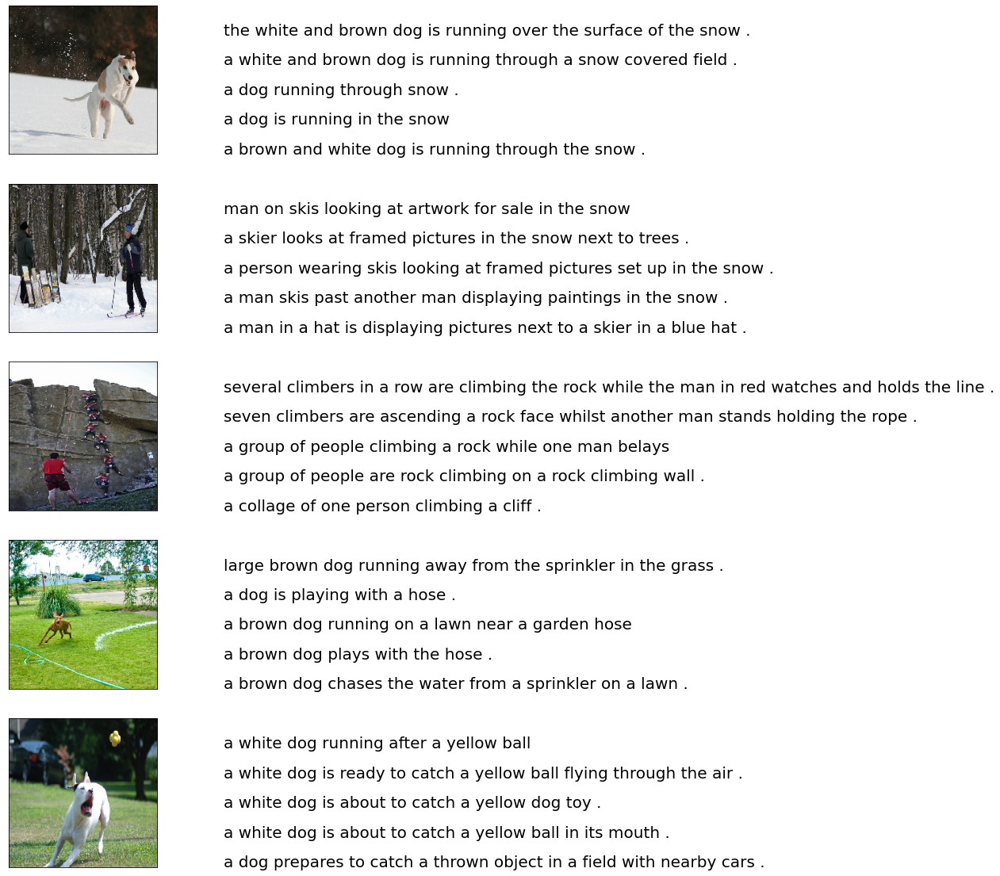

In [ ]:
from keras.preprocessing.image import load_img, img_to_array

npic = 5
npix = 224
target_size = (npix,npix,3)

count = 1
fig = plt.figure(figsize=(10,20))
for jpgfnm in uni_filenames[10:15]:
    filename = image_path + '/' + jpgfnm
    captions = list(data["caption"].loc[data["filename"]==jpgfnm].values)
    image_load = load_img(filename, target_size=target_size)
    
    ax = fig.add_subplot(npic,2,count,xticks=[],yticks=[])
    ax.imshow(image_load)
    count += 1
    
    ax = fig.add_subplot(npic,2,count)
    plt.axis('off')
    ax.plot()
    ax.set_xlim(0,1)
    ax.set_ylim(0,len(captions))
    for i, caption in enumerate(captions):
        ax.text(0,i,caption,fontsize=20)
    count += 1
plt.show()

In [ ]:
# Get all the words available i the captions by splitting the sentences

In [ ]:
vocabulary = []
for txt in data.caption.values:
    vocabulary.extend(txt.split())
print('Vocabulary Size: %d' % len(set(vocabulary)))

Vocabulary Size: 8918


In [ ]:
# crearting a list of Image file names and captions

In [ ]:
img = data["filename"].tolist()
caption = data["caption"].tolist()

In [ ]:
print(f"len(img) : {len(img)}")
print(f"len(caption) : {len(caption)}")

len(img) : 40455
len(caption) : 40455


In [ ]:
""" Removing punctuations , Single characters , Numeric values from the word/Vocabulary , having them would make increase the probability of such words over others due to repetitive usage
giving undesired results """
# To remove punctuations
def remove_punctuation(text_original):
    text_no_punctuation = text_original.translate(string.punctuation)
    return(text_no_punctuation)

# To remove single characters
def remove_single_character(text):
    text_len_more_than1 = ""
    for word in text.split():
        if len(word) > 1:
            text_len_more_than1 += " " + word
    return(text_len_more_than1)

# To remove numeric values
def remove_numeric(text):
    text_no_numeric = ""
    for word in text.split():
        isalpha = word.isalpha()
        if isalpha:
            text_no_numeric += " " + word
    return(text_no_numeric)

In [ ]:
""" Cleaning up the original text without punctuations, single characters and numeric values """

' Cleaning up the original text without punctuations, single characters and numeric values '

In [ ]:
def text_clean(text_original):
    text = remove_punctuation(text_original)
    text = remove_single_character(text)
    text = remove_numeric(text)
    return(text)
    
for i, caption in enumerate(data.caption.values):
    newcaption = text_clean(caption)
    data["caption"].iloc[i] = newcaption

In [ ]:
#building clean vocabulary
clean_vocabulary = []
for txt in data.caption.values:
    clean_vocabulary.extend(txt.split())
print('Clean Vocabulary Size: %d' % len(set(clean_vocabulary)))

Clean Vocabulary Size: 8357


In [ ]:
# adding <start> and <end> tags to sentences to identify the start and end of the sentences while looping through words in sentence
PATH = "/content/Flicker8k_Dataset/"
all_captions = []

for caption  in data["caption"].astype(str):
    caption = '<start> ' + caption+ ' <end>'
    all_captions.append(caption)
all_captions[:10]

['<start>  child in pink dress is climbing up set of stairs in an entry way <end>',
 '<start>  girl going into wooden building <end>',
 '<start>  little girl climbing into wooden playhouse <end>',
 '<start>  little girl climbing the stairs to her playhouse <end>',
 '<start>  little girl in pink dress going into wooden cabin <end>',
 '<start>  black dog and spotted dog are fighting <end>',
 '<start>  black dog and dog playing with each other on the road <end>',
 '<start>  black dog and white dog with brown spots are staring at each other in the street <end>',
 '<start>  two dogs of different breeds looking at each other on the road <end>',
 '<start>  two dogs on pavement moving toward each other <end>']

In [ ]:
#building path to read each image from the content downloaded
all_img_name_vector = []

for annot in data["filename"]:
    full_image_path = PATH + annot

    all_img_name_vector.append(full_image_path)
all_img_name_vector[:10]

['/content/Flicker8k_Dataset/1000268201_693b08cb0e.jpg',
 '/content/Flicker8k_Dataset/1000268201_693b08cb0e.jpg',
 '/content/Flicker8k_Dataset/1000268201_693b08cb0e.jpg',
 '/content/Flicker8k_Dataset/1000268201_693b08cb0e.jpg',
 '/content/Flicker8k_Dataset/1000268201_693b08cb0e.jpg',
 '/content/Flicker8k_Dataset/1001773457_577c3a7d70.jpg',
 '/content/Flicker8k_Dataset/1001773457_577c3a7d70.jpg',
 '/content/Flicker8k_Dataset/1001773457_577c3a7d70.jpg',
 '/content/Flicker8k_Dataset/1001773457_577c3a7d70.jpg',
 '/content/Flicker8k_Dataset/1001773457_577c3a7d70.jpg']

In [ ]:
print(f"len(all_img_name_vector) : {len(all_img_name_vector)}")
print(f"len(all_captions) : {len(all_captions)}")

len(all_img_name_vector) : 40455
len(all_captions) : 40455


In [ ]:
def data_limiter(num,total_captions,all_img_name_vector):
  train_captions, img_name_vector = shuffle(total_captions,all_img_name_vector,random_state=1)
  train_captions = train_captions[:num]
  img_name_vector = img_name_vector[:num]
  return train_captions,img_name_vector

In [ ]:
train_captions,img_name_vector = data_limiter(40000,all_captions,all_img_name_vector)

In [ ]:
print(f"len(all_img_name_vector) : {len(img_name_vector)}")
print(f"len(all_captions) : {len(train_captions)}")

len(all_img_name_vector) : 40000
len(all_captions) : 40000


In [ ]:
#Loading an image with (224,224,3) for passing to Encoder Resnet50
def load_image(image_path):
    img = tf.io.read_file(image_path)
    img = tf.image.decode_jpeg(img, channels=3)
    img = tf.image.resize(img, (224, 224))
    return img, image_path

In [ ]:
image_model_ic = tf.keras.applications.InceptionV3(include_top=False,weights='imagenet')
#Using Pretrained Resnet50 as encoder and taking Input size of (224,224,3)
image_model = ResNet50(include_top=False,weights='imagenet',input_shape=(224, 224,3),pooling="avg")
new_input = image_model.input
hidden_layer = image_model.layers[-2].output

image_features_extract_model = tf.keras.Model(new_input, hidden_layer)

94781440/94765736 [==============================] - 0s 0us/step


In [ ]:
image_model_ic.summary()

Model: "inception_v3"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, None, None,  0           []                               
                                 3)]                                                              
                                                                                                  
 conv2d (Conv2D)                (None, None, None,   864         ['input_1[0][0]']                
                                32)                                                               
                                                                                                  
 batch_normalization (BatchNorm  (None, None, None,   96         ['conv2d[0][0]']                 
 alization)                     32)                                                    

In [ ]:
image_model.summary()

Model: "resnet50"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_2 (InputLayer)           [(None, 224, 224, 3  0           []                               
                                )]                                                                
                                                                                                  
 conv1_pad (ZeroPadding2D)      (None, 230, 230, 3)  0           ['input_2[0][0]']                
                                                                                                  
 conv1_conv (Conv2D)            (None, 112, 112, 64  9472        ['conv1_pad[0][0]']              
                                )                                                                 
                                                                                           

In [ ]:
# Get unique images
encode_train = sorted(set(img_name_vector))

# Batch size 16
image_dataset = tf.data.Dataset.from_tensor_slices(encode_train)
image_dataset = image_dataset.map(
  load_image, num_parallel_calls=tf.data.experimental.AUTOTUNE).batch(16)
#Building Image feature vector using Resnet50 Encoder
for img, path in tqdm(image_dataset):
  batch_features = image_features_extract_model(img)
  # converting image from Resnet (16,7,7,2048) to (16,49,2048)
  batch_features = tf.reshape(batch_features,
                              (batch_features.shape[0], -1, batch_features.shape[3]))

  for bf, p in zip(batch_features, path):
    path_of_feature = p.numpy().decode("utf-8")
    np.save(path_of_feature, bf.numpy())

100%|██████████| 506/506 [01:22<00:00,  6.17it/s]


In [ ]:
#temp code
for img1, path1 in tqdm(image_dataset):
  batch_features1 = image_features_extract_model(img1)
  print("shape",batch_features1.shape)
  print("batch_features.shape[0]",batch_features1.shape[0])
  print("batch_features.shape[1]",batch_features1.shape[1])
  print("batch_features.shape[2]",batch_features1.shape[2])
  print("batch_features.shape[3]",batch_features1.shape[3])
  batch_features2 = tf.reshape(batch_features1,
                              (batch_features1.shape[0], -1, batch_features1.shape[3]))
  print("shape",batch_features2.shape)
  print("batch_features2.shape[0]",batch_features2.shape[0])
  print("batch_features2.shape[1]",batch_features2.shape[1])
  print("batch_features2.shape[2]",batch_features2.shape[2])
  #print("batch_features2.shape[3]",batch_features2.shape[3])
  break

  0%|          | 0/506 [00:00<?, ?it/s]

shape (16, 7, 7, 2048)
batch_features.shape[0] 16
batch_features.shape[1] 7
batch_features.shape[2] 7
batch_features.shape[3] 2048
shape (16, 49, 2048)
batch_features2.shape[0] 16
batch_features2.shape[1] 49
batch_features2.shape[2] 2048


### Preprocess and tokenize the captions

In [ ]:
top_k = 5000

In [ ]:
#Building a Word embedding for top 5000 words in the captions
tokenizer = tf.keras.preprocessing.text.Tokenizer(num_words=top_k,
                                                  oov_token="<unk>",
                                                  filters='!"#$%&()*+.,-/:;=?@[\]^_`{|}~ ')
tokenizer.fit_on_texts(train_captions)
train_seqs = tokenizer.texts_to_sequences(train_captions)

In [ ]:
tokenizer.word_index['<pad>'] = 0
tokenizer.index_word[0] = '<pad>'

In [ ]:
train_seqs = tokenizer.texts_to_sequences(train_captions)

In [ ]:
cap_vector = tf.keras.preprocessing.sequence.pad_sequences(train_seqs, padding='post')

In [ ]:
cap_vector.shape # Maximum number of words in a sentence is 33 (in the captions dataset)

(40000, 33)

### Split the data into training and testing

In [ ]:
img_name_train, img_name_val, cap_train, cap_val = train_test_split(img_name_vector,
                                                                    cap_vector,
                                                                    test_size=0.2,
                                                                    random_state=0)

In [ ]:
len(img_name_train), len(cap_train), len(img_name_val), len(cap_val)

(32000, 32000, 8000, 8000)

### Create a tf.data dataset for training

In [ ]:
#Temp code
print(cap_train.shape)
print (type(cap_train))
cap_train[0,:]

(32000, 33)
<class 'numpy.ndarray'>


array([  2,  11, 922,  29, 171,  20,  29, 159,   6,  84, 110,   3,   0,
         0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
         0,   0,   0,   0,   0,   0,   0], dtype=int32)

In [ ]:
BATCH_SIZE = 64
BUFFER_SIZE = 1000
num_steps = len(img_name_train) // BATCH_SIZE

In [ ]:
def map_func(img_name, cap):
  img_tensor = np.load(img_name.decode('utf-8')+'.npy')
  return img_tensor, cap

In [ ]:
# Check what is this ?
dataset = tf.data.Dataset.from_tensor_slices((img_name_train, cap_train))

# Use map to load the numpy files in parallel
dataset = dataset.map(lambda item1, item2: tf.numpy_function(
          map_func, [item1, item2], [tf.float32, tf.int32]),
          num_parallel_calls=tf.data.experimental.AUTOTUNE)

# Shuffle and batch
dataset = dataset.shuffle(BUFFER_SIZE).batch(BATCH_SIZE)
dataset = dataset.prefetch(buffer_size=tf.data.experimental.AUTOTUNE)

In [ ]:
def get_angles(pos, i, d_model):
   angle_rates = 1 / np.power(10000, (2 * (i//2)) / np.float32(d_model))
   return pos * angle_rates

In [ ]:
# Position encoding for 1d vectors ( Word embedding)
def positional_encoding_1d(position, d_model):
  angle_rads = get_angles(np.arange(position)[:, np.newaxis],
                          np.arange(d_model)[np.newaxis, :],
                          d_model)
  
  # apply sin to even indices in the array; 2i
  angle_rads[:, 0::2] = np.sin(angle_rads[:, 0::2])
  
  # apply cos to odd indices in the array; 2i+1
  angle_rads[:, 1::2] = np.cos(angle_rads[:, 1::2])
    
  pos_encoding = angle_rads[np.newaxis, ...]
    
  return tf.cast(pos_encoding, dtype=tf.float32)

In [ ]:
# Position encoding for 2d vectors (image)
#Input (Batch Size, H*W , Dense layer from Encoder)
def positional_encoding_2d(row,col,d_model):
  assert d_model % 2 == 0
  # first d_model/2 encode row embedding and second d_model/2 encode column embedding
  row_pos = np.repeat(np.arange(row),col)[:,np.newaxis]
  col_pos = np.repeat(np.expand_dims(np.arange(col),0),row,axis=0).reshape(-1,1)
  angle_rads_row = get_angles(row_pos,np.arange(d_model//2)[np.newaxis,:],d_model//2)
  angle_rads_col = get_angles(col_pos,np.arange(d_model//2)[np.newaxis,:],d_model//2)
  #apply sin and cos to odd and even indices resp.
  angle_rads_row[:, 0::2] = np.sin(angle_rads_row[:, 0::2])
  angle_rads_row[:, 1::2] = np.cos(angle_rads_row[:, 1::2])
  angle_rads_col[:, 0::2] = np.sin(angle_rads_col[:, 0::2])
  angle_rads_col[:, 1::2] = np.cos(angle_rads_col[:, 1::2])
  pos_encoding = np.concatenate([angle_rads_row,angle_rads_col],axis=1)[np.newaxis, ...]

  return tf.cast(pos_encoding, dtype=tf.float32)


In [ ]:
def create_padding_mask(seq):
  seq = tf.cast(tf.math.equal(seq, 0), tf.float32)
  
  # add extra dimensions to add the padding
  # to the attention logits.
  return seq[:, tf.newaxis, tf.newaxis, :]  # (batch_size, 1, 1, seq_len)

In [ ]:
def create_look_ahead_mask(size):
  mask = 1 - tf.linalg.band_part(tf.ones((size, size)), -1, 0)
  return mask  # (seq_len, seq_len)

In [ ]:
# This block build weights for Q - Query , K - Key , V - Value for the 8 heads
def scaled_dot_product_attention(q, k, v, mask):
  """Calculate the attention weights.
  q, k, v must have matching leading dimensions.
  k, v must have matching penultimate dimension, i.e.: seq_len_k = seq_len_v.
  The mask has different shapes depending on its type(padding or look ahead) 
  but it must be broadcastable for addition.
  
  Args:
    q: query shape == (..., seq_len_q, depth)
    k: key shape == (..., seq_len_k, depth)
    v: value shape == (..., seq_len_v, depth_v)
    mask: Float tensor with shape broadcastable 
          to (..., seq_len_q, seq_len_k). Defaults to None.
    
  Returns:
    output, attention_weights
  """

  matmul_qk = tf.matmul(q, k, transpose_b=True)  # (..., seq_len_q, seq_len_k)
  
  # scale matmul_qk
  dk = tf.cast(tf.shape(k)[-1], tf.float32)
  scaled_attention_logits = matmul_qk / tf.math.sqrt(dk)

  # add the mask to the scaled tensor.
  if mask is not None:
    scaled_attention_logits += (mask * -1e9)  #adding -Inf where mask is 1 s.t. value get ignored in softmax

  # softmax is normalized on the last axis (seq_len_k) so that the scores
  # add up to 1.
  attention_weights = tf.nn.softmax(scaled_attention_logits, axis=-1)  # (..., seq_len_q, seq_len_k)

  output = tf.matmul(attention_weights, v)  # (..., seq_len_q, depth_v)

  return output, attention_weights

In [ ]:
""" This class build Multihead attention layer with number of heads passed ( 8 as per paper) and builds
Weigth for q - Query , k - Key , v - Value  . Weights matrix will be as many as number of heads """
class MultiHeadAttention(tf.keras.layers.Layer):
  def __init__(self, d_model, num_heads):
    super(MultiHeadAttention, self).__init__()
    self.num_heads = num_heads
    self.d_model = d_model
    
    assert d_model % self.num_heads == 0
    
    self.depth = d_model // self.num_heads
    
    self.wq = tf.keras.layers.Dense(d_model)
    self.wk = tf.keras.layers.Dense(d_model)
    self.wv = tf.keras.layers.Dense(d_model)
    
    self.dense = tf.keras.layers.Dense(d_model)
        
  def split_heads(self, x, batch_size):
    """Split the last dimension into (num_heads, depth).
    Transpose the result such that the shape is (batch_size, num_heads, seq_len, depth)
    """
    #
    x = tf.reshape(x, (batch_size, -1, self.num_heads, self.depth))
    return tf.transpose(x, perm=[0, 2, 1, 3])
    
  def call(self, v, k, q, mask=None):
    batch_size = tf.shape(q)[0]
    
    q = self.wq(q)  # (batch_size, seq_len, d_model)
    k = self.wk(k)  # (batch_size, seq_len, d_model)
    v = self.wv(v)  # (batch_size, seq_len, d_model)
    
    q = self.split_heads(q, batch_size)  # (batch_size, num_heads, seq_len_q, depth)
    k = self.split_heads(k, batch_size)  # (batch_size, num_heads, seq_len_k, depth)
    v = self.split_heads(v, batch_size)  # (batch_size, num_heads, seq_len_v, depth)
    
    # scaled_attention.shape == (batch_size, num_heads, seq_len_q, depth)
    # attention_weights.shape == (batch_size, num_heads, seq_len_q, seq_len_k)
    scaled_attention, attention_weights = scaled_dot_product_attention(
        q, k, v, mask)
    
    scaled_attention = tf.transpose(scaled_attention, perm=[0, 2, 1, 3])  # (batch_size, seq_len_q, num_heads, depth)

    concat_attention = tf.reshape(scaled_attention, 
                                  (batch_size, -1, self.d_model))  # (batch_size, seq_len_q, d_model)

    output = self.dense(concat_attention)  # (batch_size, seq_len_q, d_model)
        
    return output, attention_weights

In [ ]:
# fucntion converts the Feedforward layer vector to Model size ( 512 in this case)
def point_wise_feed_forward_network(d_model, dff):
  return tf.keras.Sequential([
      tf.keras.layers.Dense(dff, activation='relu'),  # (batch_size, seq_len, dff)
      tf.keras.layers.Dense(d_model)  # (batch_size, seq_len, d_model)
  ])

In [ ]:
""" Within this block the Multihead attention layer is built to get weights for q,k,v 
 The output of MHA is passed to FFN and normalization"""
class EncoderLayer(tf.keras.layers.Layer):
  def __init__(self, d_model, num_heads, dff, rate=0.1):
    super(EncoderLayer, self).__init__()

    self.mha = MultiHeadAttention(d_model, num_heads)
    self.ffn = point_wise_feed_forward_network(d_model, dff)

    self.layernorm1 = tf.keras.layers.LayerNormalization(epsilon=1e-6)
    self.layernorm2 = tf.keras.layers.LayerNormalization(epsilon=1e-6)
    
    self.dropout1 = tf.keras.layers.Dropout(rate)
    self.dropout2 = tf.keras.layers.Dropout(rate)
    
  def call(self, x, training, mask=None):

    attn_output, _ = self.mha(x, x, x, mask)  # (batch_size, input_seq_len, d_model)
    attn_output = self.dropout1(attn_output, training=training)
    out1 = self.layernorm1(x + attn_output)  # (batch_size, input_seq_len, d_model)
    
    ffn_output = self.ffn(out1)  # (batch_size, input_seq_len, d_model)
    ffn_output = self.dropout2(ffn_output, training=training)
    out2 = self.layernorm2(out1 + ffn_output)  # (batch_size, input_seq_len, d_model)
    
    return out2

In [ ]:
""" Decoder layer will build two MHA 
1. MHA1 = Word Embedding + Position Encoding
2. MHA2 = MHA1 + MHA_ecoded( image)
Then it creates a Feedforward layer with d_model channels ( 512 here)
Returns  batch normalized output with MHA1 and MHA2 Attention weights"""
class DecoderLayer(tf.keras.layers.Layer):
  def __init__(self, d_model, num_heads, dff, rate=0.1):
    super(DecoderLayer, self).__init__()

    self.mha1 = MultiHeadAttention(d_model, num_heads)
    self.mha2 = MultiHeadAttention(d_model, num_heads)

    self.ffn = point_wise_feed_forward_network(d_model, dff)
 
    self.layernorm1 = tf.keras.layers.LayerNormalization(epsilon=1e-6)
    self.layernorm2 = tf.keras.layers.LayerNormalization(epsilon=1e-6)
    self.layernorm3 = tf.keras.layers.LayerNormalization(epsilon=1e-6)
    
    self.dropout1 = tf.keras.layers.Dropout(rate)
    self.dropout2 = tf.keras.layers.Dropout(rate)
    self.dropout3 = tf.keras.layers.Dropout(rate)
    
    
  def call(self, x, enc_output, training, 
           look_ahead_mask=None, padding_mask=None):
    # enc_output.shape == (batch_size, input_seq_len, d_model)

    # using look ahead mask so that during self attention current query dont consider future token
    attn1, attn_weights_block1 = self.mha1(x, x, x, look_ahead_mask)  # (batch_size, target_seq_len, d_model)
    attn1 = self.dropout1(attn1, training=training)
    out1 = self.layernorm1(attn1 + x)
    
    # use padding mask to avoid padded values of both enc_output and dec_input
    attn2, attn_weights_block2 = self.mha2(
        enc_output, enc_output, out1, padding_mask)  # (batch_size, target_seq_len, d_model)
    attn2 = self.dropout2(attn2, training=training)
    out2 = self.layernorm2(attn2 + out1)  # (batch_size, target_seq_len, d_model)
    
    ffn_output = self.ffn(out2)  # (batch_size, target_seq_len, d_model)
    ffn_output = self.dropout3(ffn_output, training=training)
    out3 = self.layernorm3(ffn_output + out2)  # (batch_size, target_seq_len, d_model)
    
    return out3, attn_weights_block1, attn_weights_block2

num_layer = 4
d_model = 512
dff = 2048
num_heads = 8
row_size = 7
col_size = 7
target_vocab_size = top_k + 1 # top_k = 5000
dropout_rate = 0.1

In [ ]:
"""Encoder to the following
Input - Takes Image Feature vector from Resnet50 
Adds position encoding to Image vector , builds an attention vector for the image
Output - updated Image vector with attention calculated  
 """
class Encoder(tf.keras.layers.Layer):
  def __init__(self, num_layers, d_model, num_heads, dff,
               row_size,col_size,rate=0.1):
    super(Encoder, self).__init__()

    self.d_model = d_model
    self.num_layers = num_layers
    
    self.embedding = tf.keras.layers.Dense(self.d_model,activation='relu')
    self.pos_encoding = positional_encoding_2d(row_size,col_size, 
                                            self.d_model)
    
    
    self.enc_layers = [EncoderLayer(d_model, num_heads, dff, rate) 
                       for _ in range(num_layers)]
  
    self.dropout = tf.keras.layers.Dropout(rate)
        
  def call(self, x, training, mask=None):
    # shape(x) = (batch_size,seq_len(H*W),features)
    seq_len = tf.shape(x)[1]
    
    # adding embedding and position encoding.
    x = self.embedding(x)  # (batch_size, input_seq_len(H*W), d_model)
    x += self.pos_encoding[:, :seq_len, :]

    x = self.dropout(x, training=training)
    
    for i in range(self.num_layers):
      x = self.enc_layers[i](x, training, mask) # Encode layer is execture 4 times ?
    
    return x  # (batch_size, input_seq_len, d_model)

In [ ]:
""" Decoder take the Word emdedding as input adds the Postion encoding to it and build a new embedding
New embedding is passed to the Decoder layer . Two key calcualtions happen in DecoderLayer
1. Calculation of Attention weights for New Word embedding 
2. Calculation of attention weights for Word Embedding + Attention Image ( out of Encoded layer)
This is passed to a feed forward output is derived"""
class Decoder(tf.keras.layers.Layer):
  def __init__(self, num_layers, d_model, num_heads, dff, target_vocab_size,
               maximum_position_encoding, rate=0.1):
    super(Decoder, self).__init__()

    self.d_model = d_model
    self.num_layers = num_layers
    
    self.embedding = tf.keras.layers.Embedding(target_vocab_size, d_model)
    self.pos_encoding = positional_encoding_1d(maximum_position_encoding, d_model)
    
    self.dec_layers = [DecoderLayer(d_model, num_heads, dff, rate) 
                       for _ in range(num_layers)]
    self.dropout = tf.keras.layers.Dropout(rate)
    
  def call(self, x, enc_output, training, 
           look_ahead_mask=None, padding_mask=None):

    seq_len = tf.shape(x)[1]
    attention_weights = {}
    
    x = self.embedding(x)  # (batch_size, target_seq_len, d_model)
    x *= tf.math.sqrt(tf.cast(self.d_model, tf.float32))# WHY ?
    x += self.pos_encoding[:, :seq_len, :]
    
    x = self.dropout(x, training=training)

    for i in range(self.num_layers):
      x, block1, block2 = self.dec_layers[i](x, enc_output, training,
                                             look_ahead_mask, padding_mask)
      
      attention_weights['decoder_layer{}_block1'.format(i+1)] = block1
      attention_weights['decoder_layer{}_block2'.format(i+1)] = block2
    
    # x.shape == (batch_size, target_seq_len, d_model)
    return x, attention_weights

In [ ]:
""" This class build Encoder , Decoder and Encoder+ decoder inputs and passes build a layer size Vocab
The out of this class would a predicted """
class Transformer(tf.keras.Model):
#_int_(num_layers = 4, d_model=512 , num_heads = 8, dff=2048,row_size=7,col_soze = 7, target_vocab_size = 5000+1 
#,max_pos_encoding = vocab_size,rate=0.1 )
  def __init__(self, num_layers, d_model, num_heads, dff,row_size,col_size, 
               target_vocab_size,max_pos_encoding, rate=0.1):
    super(Transformer, self).__init__()

    self.encoder = Encoder(num_layers, d_model, num_heads, dff,row_size,col_size, rate)

    self.decoder = Decoder(num_layers, d_model, num_heads, dff, 
                           target_vocab_size,max_pos_encoding, rate)

    self.final_layer = tf.keras.layers.Dense(target_vocab_size)
# inp = Image tensor , tar = Word embedding , training = True 
  def call(self, inp, tar, training,look_ahead_mask=None, dec_padding_mask=None,enc_padding_mask=None):

    enc_output = self.encoder(inp, training, enc_padding_mask)  # (batch_size, inp_seq_len, d_model)
    
    # dec_output.shape == (batch_size, tar_seq_len, d_model)
    dec_output, attention_weights = self.decoder(
        tar, enc_output, training, look_ahead_mask, dec_padding_mask)
    
    final_output = self.final_layer(dec_output)  # (batch_size, tar_seq_len, target_vocab_size)
    
    return final_output, attention_weights

In [ ]:
num_layer = 4
d_model = 512
dff = 2048
num_heads = 8
row_size = 7
col_size = 7
target_vocab_size = top_k + 1 # top_k = 5000
dropout_rate = 0.1

In [ ]:
#transformer = Transformer(num_layer,d_model,num_heads,dff,row_size,col_size,target_vocab_size,max_pos_encoding=target_vocab_size,rate=dropout_rate)

In [ ]:
print (target_vocab_size)

5001


In [ ]:
np.arange(target_vocab_size)

array([   0,    1,    2, ..., 4998, 4999, 5000])

In [ ]:
# Temp code
angle_check = get_angles(np.arange(target_vocab_size)[:, np.newaxis],
                          np.arange(512)[np.newaxis, :],
                          512)
print (angle_check.shape)
print(type(angle_check))

(5001, 512)
<class 'numpy.ndarray'>


In [ ]:
# Temp code
# apply sin to even indices in the array; 2i
angle_check[:, 0::2] = np.sin(angle_check[:, 0::2])
print(angle_check.shape)
# apply cos to odd indices in the array; 2i+1
angle_check[:, 1::2] = np.cos(angle_check[:, 1::2])
pos_encoding_check = angle_check[np.newaxis, ...]
print(pos_encoding_check.shape)

(5001, 512)
(1, 5001, 512)


In [ ]:
  # Temp code
  row_pos1 = np.repeat(np.arange(8),8)[:,np.newaxis]
  print("row_pos1", row_pos1.shape)
  col_pos1 = np.repeat(np.expand_dims(np.arange(8),0),8,axis=0).reshape(-1,1)
  print("row_pos1", col_pos1.shape)
  angle_rads_row1 = get_angles(row_pos1,np.arange(512//2)[np.newaxis,:],d_model//2)
  print("angle_rads_row1", angle_rads_row1.shape)
  angle_rads_col1 = get_angles(col_pos1,np.arange(512//2)[np.newaxis,:],d_model//2)
  print("angle_rads_col1", angle_rads_col1.shape)
  #apply sin and cos to odd and even indices resp.
  angle_rads_row1[:, 0::2] = np.sin(angle_rads_row1[:, 0::2])
  angle_rads_row1[:, 1::2] = np.cos(angle_rads_row1[:, 1::2])
  print("angle_rads_row1-1", angle_rads_row1.shape)
  print("angle_rads_col1-1", angle_rads_col1.shape)
  angle_rads_col1[:, 0::2] = np.sin(angle_rads_col1[:, 0::2])
  angle_rads_col1[:, 1::2] = np.cos(angle_rads_col1[:, 1::2])
  print("angle_rads_row1-2", angle_rads_row1.shape)
  print("angle_rads_col1-2", angle_rads_col1.shape)
  pos_encoding1 = np.concatenate([angle_rads_row1,angle_rads_col1],axis=1)[np.newaxis, ...]
  print("pos_encoding1", pos_encoding1.shape)

row_pos1 (64, 1)
row_pos1 (64, 1)
angle_rads_row1 (64, 256)
angle_rads_col1 (64, 256)
angle_rads_row1-1 (64, 256)
angle_rads_col1-1 (64, 256)
angle_rads_row1-2 (64, 256)
angle_rads_col1-2 (64, 256)
pos_encoding1 (1, 64, 512)


In [ ]:
# What is this?
class CustomSchedule(tf.keras.optimizers.schedules.LearningRateSchedule):
  def __init__(self, d_model, warmup_steps=4000):
    super(CustomSchedule, self).__init__()
    
    self.d_model = d_model
    self.d_model = tf.cast(self.d_model, tf.float32)

    self.warmup_steps = warmup_steps
    
  def __call__(self, step):
    arg1 = tf.math.rsqrt(step)
    arg2 = step * (self.warmup_steps ** -1.5)
    
    return tf.math.rsqrt(self.d_model) * tf.math.minimum(arg1, arg2)

In [ ]:
learning_rate = CustomSchedule(d_model)

optimizer = tf.keras.optimizers.Adam(learning_rate, beta_1=0.9, beta_2=0.98, 
                                     epsilon=1e-9)

In [ ]:
loss_object = tf.keras.losses.SparseCategoricalCrossentropy(
    from_logits=True, reduction='none')

In [ ]:
def loss_function(real, pred):
  mask = tf.math.logical_not(tf.math.equal(real, 0))
  loss_ = loss_object(real, pred)

  mask = tf.cast(mask, dtype=loss_.dtype)
  loss_ *= mask
  
  return tf.reduce_sum(loss_)/tf.reduce_sum(mask)

In [ ]:
train_loss = tf.keras.metrics.Mean(name='train_loss')
train_accuracy = tf.keras.metrics.SparseCategoricalAccuracy(
    name='train_accuracy')

In [ ]:
transformer = Transformer(num_layer,d_model,num_heads,dff,row_size,col_size,target_vocab_size,max_pos_encoding=target_vocab_size,rate=dropout_rate)

In [ ]:
def create_masks_decoder(tar):
  look_ahead_mask = create_look_ahead_mask(tf.shape(tar)[1])
  dec_target_padding_mask = create_padding_mask(tar)
  combined_mask = tf.maximum(dec_target_padding_mask, look_ahead_mask)
  return combined_mask

In [ ]:
@tf.function
#Image tensor and correspoding caption is passed to train_step
def train_step(img_tensor, tar):
  tar_inp = tar[:, :-1] ## all word embedding except the <end>
  tar_real = tar[:, 1:] ## all word embedding except the <start>
  
  dec_mask = create_masks_decoder(tar_inp)# Setting all embeddding for future words to 0 and taking only previous words
  
  with tf.GradientTape() as tape:
    predictions, _ = transformer(img_tensor, tar_inp, 
                                 True,  
                                 dec_mask)
    loss = loss_function(tar_real, predictions)

  gradients = tape.gradient(loss, transformer.trainable_variables)    
  optimizer.apply_gradients(zip(gradients, transformer.trainable_variables))
  
  train_loss(loss)
  train_accuracy(tar_real, predictions)

In [ ]:
 #temp code
 for (batch1, (img_tensor1, tar1)) in enumerate(dataset):
     print("img_tensor1", img_tensor1.shape)
     print("tar1" , tar1.shape)
     print( tar1[:, :-1].shape)
     print( tar1[:, 1:].shape)
     dec_mask1 = create_masks_decoder(tar1[:, :-1])
     print(dec_mask1.shape)
     break

img_tensor1 (64, 49, 2048)
tar1 (64, 33)
(64, 32)
(64, 32)
(64, 1, 32, 32)


In [ ]:
#Epochs = 70 , Data set returns Image and All captions for images which are passed to train_step function
for epoch in range(70):
  start = time.time()
  
  train_loss.reset_states()
  train_accuracy.reset_states()
  
  for (batch, (img_tensor, tar)) in enumerate(dataset):
    train_step(img_tensor, tar)
    
    if batch % 50 == 0:
      print ('Epoch {} Batch {} Loss {:.4f} Accuracy {:.4f}'.format(
          epoch + 1, batch, train_loss.result(), train_accuracy.result()))
      
    
  print ('Epoch {} Loss {:.4f} Accuracy {:.4f}'.format(epoch + 1, 
                                                train_loss.result(), 
                                                train_accuracy.result()))

  print ('Time taken for 1 epoch: {} secs\n'.format(time.time() - start))

Epoch 1 Batch 0 Loss 8.5716 Accuracy 0.0000
Epoch 1 Batch 50 Loss 8.1275 Accuracy 0.0205
Epoch 1 Batch 100 Loss 7.7180 Accuracy 0.0258
Epoch 1 Batch 150 Loss 7.4166 Accuracy 0.0279
Epoch 1 Batch 200 Loss 7.1237 Accuracy 0.0309
Epoch 1 Batch 250 Loss 6.8455 Accuracy 0.0347
Epoch 1 Batch 300 Loss 6.5961 Accuracy 0.0386
Epoch 1 Batch 350 Loss 6.3795 Accuracy 0.0422
Epoch 1 Batch 400 Loss 6.1892 Accuracy 0.0456
Epoch 1 Batch 450 Loss 6.0200 Accuracy 0.0487
Epoch 1 Loss 5.8756 Accuracy 0.0514
Time taken for 1 epoch: 87.22046756744385 secs

Epoch 2 Batch 0 Loss 4.4034 Accuracy 0.0747
Epoch 2 Batch 50 Loss 4.4241 Accuracy 0.0800
Epoch 2 Batch 100 Loss 4.3601 Accuracy 0.0818
Epoch 2 Batch 150 Loss 4.3138 Accuracy 0.0824
Epoch 2 Batch 200 Loss 4.2662 Accuracy 0.0834
Epoch 2 Batch 250 Loss 4.2219 Accuracy 0.0842
Epoch 2 Batch 300 Loss 4.1844 Accuracy 0.0851
Epoch 2 Batch 350 Loss 4.1485 Accuracy 0.0858
Epoch 2 Batch 400 Loss 4.1106 Accuracy 0.0866
Epoch 2 Batch 450 Loss 4.0735 Accuracy 0.0876
Ep

In [ ]:
transformer.save_weights('image_caption_transformer70_resnet50.h5')

In [ ]:
def evaluate(image):

  temp_input = tf.expand_dims(load_image(image)[0], 0)
  img_tensor_val = image_features_extract_model(temp_input)
  img_tensor_val = tf.reshape(img_tensor_val, (img_tensor_val.shape[0], -1, img_tensor_val.shape[3]))
  
  start_token = tokenizer.word_index['<start>']
  end_token = tokenizer.word_index['<end>']
   
  #decoder input is start token.
  decoder_input = [start_token]
  output = tf.expand_dims(decoder_input, 0) #tokens
  result = [] #word list

  for i in range(100):
      dec_mask = create_masks_decoder(output)
  
      # predictions.shape == (batch_size, seq_len, vocab_size)
      predictions, attention_weights = transformer(img_tensor_val,output,False,dec_mask)
      
      # select the last word from the seq_len dimension
      predictions = predictions[: ,-1:, :]  # (batch_size, 1, vocab_size)

      predicted_id = tf.cast(tf.argmax(predictions, axis=-1), tf.int32)
      # return the result if the predicted_id is equal to the end token
      if predicted_id == end_token:
          return result,tf.squeeze(output, axis=0), attention_weights
      # concatentate the predicted_id to the output which is given to the decoder
      # as its input.
      result.append(tokenizer.index_word[int(predicted_id)])
      output = tf.concat([output, predicted_id], axis=-1)

  return result,tf.squeeze(output, axis=0), attention_weights

BLEU-1 score: 26.666666666666668
BLEU-2 score: 19.51800145897066
BLEU-3 score: 17.38113777029509
BLEU-4 score: 2.841632707086713e-76
Real Caption: artists working on <unk> on the ground
Predicted Caption: group of people are down on their hands and knees making something on the ground


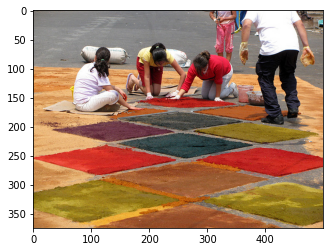

In [ ]:
start_token = tokenizer.word_index['<start>']
end_token = tokenizer.word_index['<end>']
# select random image from validation data
rid = np.random.randint(0, len(img_name_val))
image = img_name_val[rid]
real_caption = ' '.join([tokenizer.index_word[i] for i in cap_val[rid] if i not in [0]])
caption,result,attention_weights = evaluate(image)

first = real_caption.split(' ', 1)[1]
real_caption = first.rsplit(' ', 1)[0]

#remove "<unk>" in result
for i in caption:
    if i=="<unk>":
        caption.remove(i)

for i in real_caption:
    if i=="<unk>":
        real_caption.remove(i)

#remove <end> from result         
result_join = ' '.join(caption)
result_final = result_join.rsplit(' ', 1)[0]

real_appn = []
real_appn.append(real_caption.split())
reference = real_appn
candidate = caption
score = sentence_bleu(reference, candidate, weights=(1.0,0,0,0))
print(f"BLEU-1 score: {score*100}")
score = sentence_bleu(reference, candidate, weights=(0.5,0.5,0,0))
print(f"BLEU-2 score: {score*100}")
score = sentence_bleu(reference, candidate, weights=(0.3,0.3,0.3,0))
print(f"BLEU-3 score: {score*100}")
score = sentence_bleu(reference, candidate, weights=(0.25,0.25,0.25,0.25))
print(f"BLEU-4 score: {score*100}")

print ('Real Caption:', real_caption)
print ('Predicted Caption:', ' '.join(caption))
temp_image = np.array(Image.open(image))
plt.imshow(temp_image)


BLEU-1 score: 38.94003915357025
BLEU-2 score: 29.4359027552757
BLEU-3 score: 2.1983675100964736e-91
BLEU-4 score: 7.142069717037071e-153
Real Caption: black dog chases brown dog with stick through the water
Predicted Caption: two dogs playing in the water with stick


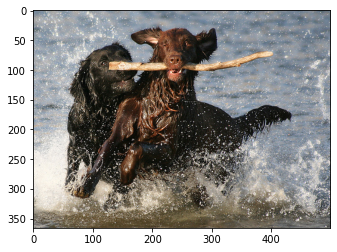

In [ ]:
start_token = tokenizer.word_index['<start>']
end_token = tokenizer.word_index['<end>']
# select random image from validation data
rid = np.random.randint(0, len(img_name_val))
image = img_name_val[rid]
real_caption = ' '.join([tokenizer.index_word[i] for i in cap_val[rid] if i not in [0]])
caption,result,attention_weights = evaluate(image)

first = real_caption.split(' ', 1)[1]
real_caption = first.rsplit(' ', 1)[0]

#remove "<unk>" in result
for i in caption:
    if i=="<unk>":
        caption.remove(i)

for i in real_caption:
    if i=="<unk>":
        real_caption.remove(i)

#remove <end> from result         
result_join = ' '.join(caption)
result_final = result_join.rsplit(' ', 1)[0]

real_appn = []
real_appn.append(real_caption.split())
reference = real_appn
candidate = caption
score = sentence_bleu(reference, candidate, weights=(1.0,0,0,0))
print(f"BLEU-1 score: {score*100}")
score = sentence_bleu(reference, candidate, weights=(0.5,0.5,0,0))
print(f"BLEU-2 score: {score*100}")
score = sentence_bleu(reference, candidate, weights=(0.3,0.3,0.3,0))
print(f"BLEU-3 score: {score*100}")
score = sentence_bleu(reference, candidate, weights=(0.25,0.25,0.25,0.25))
print(f"BLEU-4 score: {score*100}")

print ('Real Caption:', real_caption)
print ('Predicted Caption:', ' '.join(caption))
temp_image = np.array(Image.open(image))
plt.imshow(temp_image)


BLEU-1 score: 13.333333333333334
BLEU-2 score: 5.4468019467172e-153
BLEU-3 score: 1.3992273317570998e-183
BLEU-4 score: 1.1008876702055895e-229
Real Caption: woman on trike and team of dogs
Predicted Caption: man is riding his bike behind several people on trail of water that is running


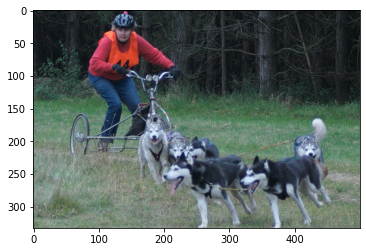

In [ ]:
start_token = tokenizer.word_index['<start>']
end_token = tokenizer.word_index['<end>']
# select random image from validation data
rid = np.random.randint(0, len(img_name_val))
image = img_name_val[rid]
real_caption = ' '.join([tokenizer.index_word[i] for i in cap_val[rid] if i not in [0]])
caption,result,attention_weights = evaluate(image)

first = real_caption.split(' ', 1)[1]
real_caption = first.rsplit(' ', 1)[0]

#remove "<unk>" in result
for i in caption:
    if i=="<unk>":
        caption.remove(i)

for i in real_caption:
    if i=="<unk>":
        real_caption.remove(i)

#remove <end> from result         
result_join = ' '.join(caption)
result_final = result_join.rsplit(' ', 1)[0]

real_appn = []
real_appn.append(real_caption.split())
reference = real_appn
candidate = caption
score = sentence_bleu(reference, candidate, weights=(1.0,0,0,0))
print(f"BLEU-1 score: {score*100}")
score = sentence_bleu(reference, candidate, weights=(0.5,0.5,0,0))
print(f"BLEU-2 score: {score*100}")
score = sentence_bleu(reference, candidate, weights=(0.3,0.3,0.3,0))
print(f"BLEU-3 score: {score*100}")
score = sentence_bleu(reference, candidate, weights=(0.25,0.25,0.25,0.25))
print(f"BLEU-4 score: {score*100}")

print ('Real Caption:', real_caption)
print ('Predicted Caption:', ' '.join(caption))
temp_image = np.array(Image.open(image))
plt.imshow(temp_image)


BLEU-1 score: 17.113903967753068
BLEU-2 score: 13.256373011140136
BLEU-3 score: 1.1530451067989366e-91
BLEU-4 score: 3.8915242969889024e-153
Real Caption: large brown dog playing with chew toy on the grass
Predicted Caption: brown dog chasing after yellow ball


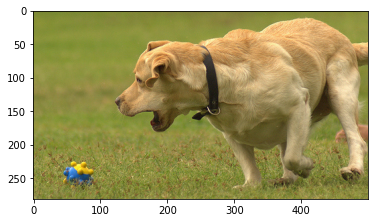

In [ ]:
start_token = tokenizer.word_index['<start>']
end_token = tokenizer.word_index['<end>']
# select random image from validation data
rid = np.random.randint(0, len(img_name_val))
image = img_name_val[rid]
real_caption = ' '.join([tokenizer.index_word[i] for i in cap_val[rid] if i not in [0]])
caption,result,attention_weights = evaluate(image)

first = real_caption.split(' ', 1)[1]
real_caption = first.rsplit(' ', 1)[0]

#remove "<unk>" in result
for i in caption:
    if i=="<unk>":
        caption.remove(i)

for i in real_caption:
    if i=="<unk>":
        real_caption.remove(i)

#remove <end> from result         
result_join = ' '.join(caption)
result_final = result_join.rsplit(' ', 1)[0]

real_appn = []
real_appn.append(real_caption.split())
reference = real_appn
candidate = caption
score = sentence_bleu(reference, candidate, weights=(1.0,0,0,0))
print(f"BLEU-1 score: {score*100}")
score = sentence_bleu(reference, candidate, weights=(0.5,0.5,0,0))
print(f"BLEU-2 score: {score*100}")
score = sentence_bleu(reference, candidate, weights=(0.3,0.3,0.3,0))
print(f"BLEU-3 score: {score*100}")
score = sentence_bleu(reference, candidate, weights=(0.25,0.25,0.25,0.25))
print(f"BLEU-4 score: {score*100}")

print ('Real Caption:', real_caption)
print ('Predicted Caption:', ' '.join(caption))
temp_image = np.array(Image.open(image))
plt.imshow(temp_image)


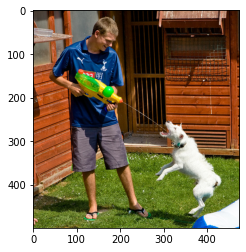

Real Caption: man spraying super <unk> into the mouth of dog
Predicted Caption: white dog pushes man on the grass
BLEU-1 score: 32.206169703226536
BLEU-2 score: 7.33837135698786e-153
BLEU-3 score: 1.4925520509868707e-183
BLEU-4 score: 1.1077199809555582e-229


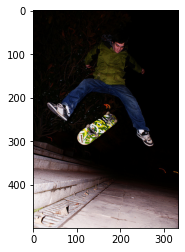

Real Caption: young man does skateboard trick near steps outside
Predicted Caption: young man in black jumps while riding skateboard
BLEU-1 score: 37.5
BLEU-2 score: 23.145502494313785
BLEU-3 score: 2.1032131949153637e-91
BLEU-4 score: 7.176381577237209e-153


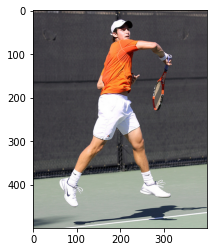

Real Caption: the tennis player holds his racket in <unk> for the ball
Predicted Caption: man in an orange shirt and white shorts playing tennis
BLEU-1 score: 18.096748360719193
BLEU-2 score: 6.036118613529225e-153
BLEU-3 score: 1.4298359405610435e-183
BLEU-4 score: 1.1023928157275092e-229


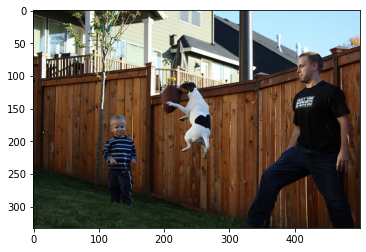

Real Caption: man and small boy watch their small white dog catch toy in the air
Predicted Caption: dog leaps over man who is jumping in the air with man and boy to catch soccer ball
BLEU-1 score: 44.44444444444444
BLEU-2 score: 28.005601680560194
BLEU-3 score: 20.282008004191916
BLEU-4 score: 3.231681603406294e-76


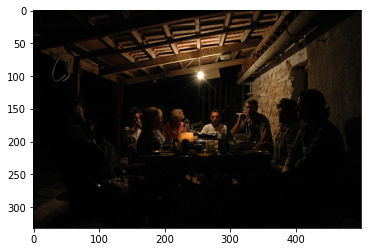

Real Caption: group of people gathered around in the dark
Predicted Caption: dark street scene with neon lights including group of people dining while another group bar
BLEU-1 score: 26.666666666666668
BLEU-2 score: 19.51800145897066
BLEU-3 score: 17.38113777029509
BLEU-4 score: 2.841632707086713e-76


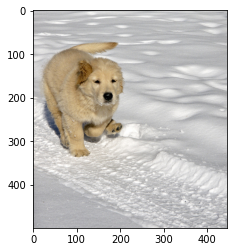

Real Caption: dog is walking in tire track in the snow
Predicted Caption: the brown dog is running in the snow
BLEU-1 score: 55.156056411537215
BLEU-2 score: 45.673553902495044
BLEU-3 score: 34.724722537572426
BLEU-4 score: 4.9543569470087646e-76


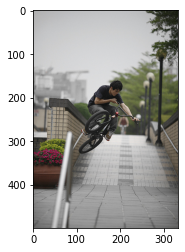

Real Caption: boy is airborne on bicycle above an urban walkway near handrail
Predicted Caption: boy in jeans black and blue cap on bike leaps over steps
BLEU-1 score: 16.666666666666668
BLEU-2 score: 6.08970970641905e-153
BLEU-3 score: 1.4961022763680928e-183
BLEU-4 score: 1.1640469867513693e-229


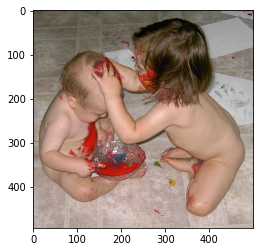

Real Caption: naked baby and toddler are playing with red fingerpaints
Predicted Caption: naked baby and toddler on the floor covered in paint the toddler putting her hands on the baby head
BLEU-1 score: 21.052631578947366
BLEU-2 score: 18.73171623163388
BLEU-3 score: 19.26286425944941
BLEU-4 score: 12.673718536830808


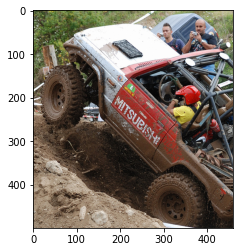

Real Caption: four wheel drive car is driving through the mud
Predicted Caption: the truck appears to be stuck in the mud
BLEU-1 score: 22.22222222222222
BLEU-2 score: 16.666666666666668
BLEU-3 score: 1.7270804940051994e-91
BLEU-4 score: 6.08970970641905e-153


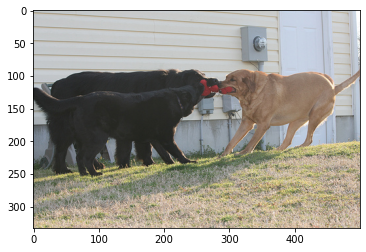

Real Caption: three large dogs one brown and the others black tussle over red toy in the grass outside building
Predicted Caption: brown dog and black dog are tugging at red object with their mouths
BLEU-1 score: 20.944996871488776
BLEU-2 score: 5.632409158840889e-153
BLEU-3 score: 1.2240673425772321e-183
BLEU-4 score: 9.236366216761734e-230


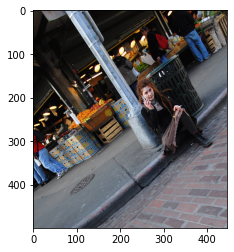

Real Caption: woman rests on the curb of city street while talking on her cellphone
Predicted Caption: woman sits on the curb while talking on her cellphone
BLEU-1 score: 66.6736398613546
BLEU-2 score: 57.38353262534609
BLEU-3 score: 51.62356966706042
BLEU-4 score: 40.08436038029661


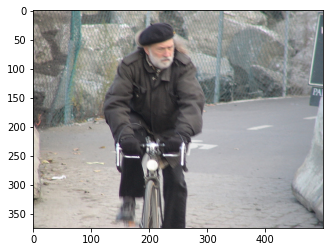

Real Caption: man wearing beret rides his bicycle on recreation trail
Predicted Caption: man in beret rides bicycle down the street
BLEU-1 score: 44.124845129229776
BLEU-2 score: 23.585721816862673
BLEU-3 score: 2.0233830542837192e-91
BLEU-4 score: 6.805395922591311e-153


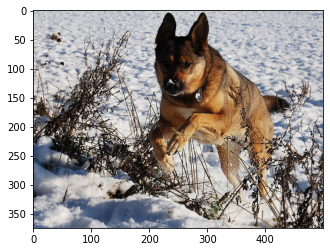

Real Caption: dog is jumping through the snow over some weeds
Predicted Caption: dog leaps through the snow
BLEU-1 score: 35.946317129377725
BLEU-2 score: 28.418058905889783
BLEU-3 score: 24.549691300049723
BLEU-4 score: 3.316157938411126e-76


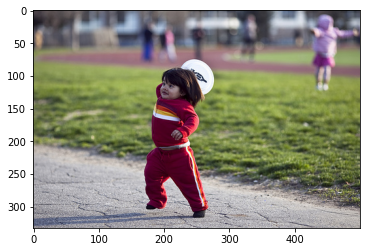

Real Caption: toddler prepares to throw frisbee
Predicted Caption: little boy in red is attempting to throw frisbee
BLEU-1 score: 33.33333333333333
BLEU-2 score: 28.867513459481287
BLEU-3 score: 26.467700653516886
BLEU-4 score: 4.034282314146679e-76


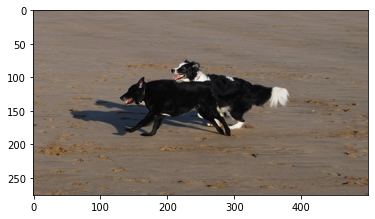

Real Caption: black dog and black and white dog are running on sandy ground
Predicted Caption: two dogs run across the barren ground
BLEU-1 score: 6.993452279385044
BLEU-2 score: 2.7600239552551947e-153
BLEU-3 score: 6.99305433449238e-184
BLEU-4 score: 5.483065946899793e-230


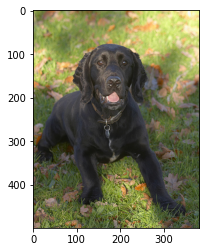

Real Caption: black puppy wearing black collar sits on the grass and leaves
Predicted Caption: black dog is looking at the camera with his mouth open
BLEU-1 score: 18.181818181818183
BLEU-2 score: 6.360494346864464e-153
BLEU-3 score: 1.5356698295026469e-183
BLEU-4 score: 1.1896457329133972e-229


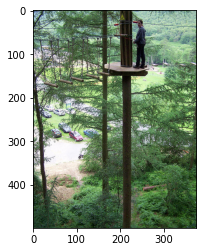

Real Caption: girl stands high on an obstacle course platform
Predicted Caption: man showering on outdoor swim board along tree
BLEU-1 score: 12.500000000000004
BLEU-2 score: 5.273843307431706e-153
BLEU-3 score: 1.372396692566494e-183
BLEU-4 score: 1.0832677820940878e-229


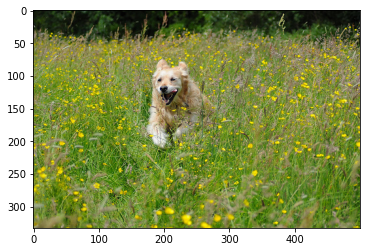

Real Caption: white dog runs through field of yellow flowers
Predicted Caption: brown dog is running through the grass
BLEU-1 score: 24.767939992862335
BLEU-2 score: 6.911878967366998e-153
BLEU-3 score: 1.5245587914760605e-183
BLEU-4 score: 1.154647032204335e-229


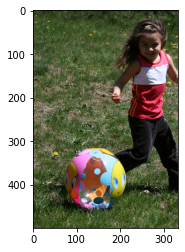

Real Caption: little girl in red and white shirt is playing with inflatable ball
Predicted Caption: little girl in colorful outfit is playing with blue and red soccer ball
BLEU-1 score: 69.23076923076923
BLEU-2 score: 48.03844614152614
BLEU-3 score: 38.622871916168314
BLEU-4 score: 5.527642039019229e-76


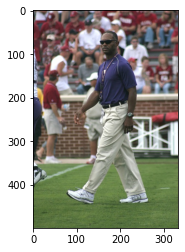

Real Caption: man in sunglasses blue shirt and beige pants walks across an athletic field
Predicted Caption: man in white watching football game
BLEU-1 score: 10.380107463819924
BLEU-2 score: 8.040396667843575
BLEU-3 score: 6.99357209305183e-92
BLEU-4 score: 2.360328799140421e-153


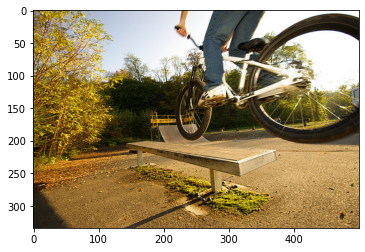

Real Caption: person performing tricks on bicycle in skate park
Predicted Caption: person in the midst of wooden structure
BLEU-1 score: 24.767939992862335
BLEU-2 score: 6.911878967366998e-153
BLEU-3 score: 1.5245587914760605e-183
BLEU-4 score: 1.154647032204335e-229


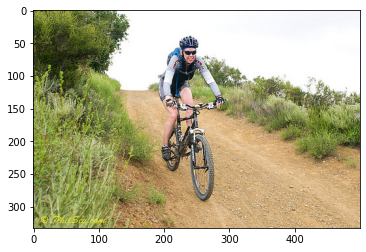

Real Caption: woman bicycles down the hill on dirt trail
Predicted Caption: person rides bike down dirt path
BLEU-1 score: 23.88437701912631
BLEU-2 score: 6.17087516772532e-153
BLEU-3 score: 1.319791889377583e-183
BLEU-4 score: 9.918892480173173e-230


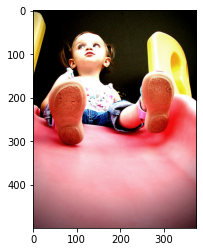

Real Caption: child gets ready to slide down the slide
Predicted Caption: the little girl in the white is playing with toy in front of blue and red toy
BLEU-1 score: 5.88235294117647
BLEU-2 score: 3.6178266619513135e-153
BLEU-3 score: 1.0946416849080909e-183
BLEU-4 score: 8.972141065609098e-230


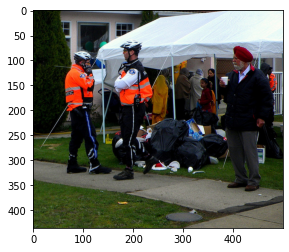

Real Caption: man in turban looks at two police officers who are near tent and pile of refuse
Predicted Caption: group of people sitting on benches at colorful police course
BLEU-1 score: 16.464349082820792
BLEU-2 score: 4.4839024317869734e-153
BLEU-3 score: 9.794140867685479e-184
BLEU-4 score: 7.399663116222943e-230


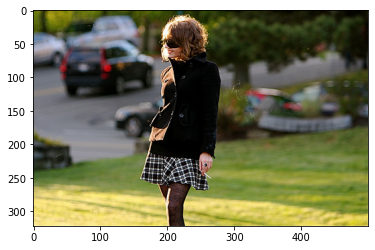

Real Caption: the woman in the black coat is standing with cigarette in her hand
Predicted Caption: man in black shirt is holding paper bottle while sitting on the shoulders of person on him with the side of the side of the ball her water fountain
BLEU-1 score: 24.137931034482758
BLEU-2 score: 7.328620562102969e-153
BLEU-3 score: 1.6719245369831186e-183
BLEU-4 score: 1.2769777614215993e-229


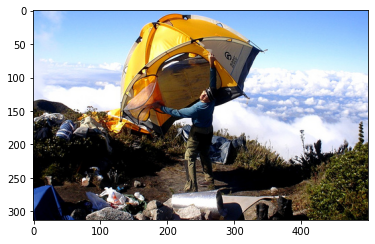

Real Caption: man holds tent on mountain campsite
Predicted Caption: man is carrying hole up his shoulders
BLEU-1 score: 14.285714285714285
BLEU-2 score: 5.637975647982814e-153
BLEU-3 score: 1.4284901392909564e-183
BLEU-4 score: 1.1200407237786664e-229


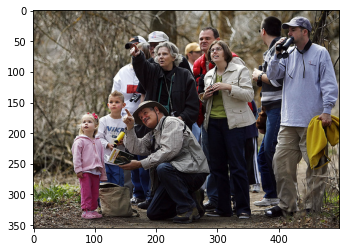

Real Caption: group of about people of all ages with binoculars in the woods
Predicted Caption: group of people are being lead on an outdoor tour with an older tour guide
BLEU-1 score: 26.666666666666668
BLEU-2 score: 13.801311186847082
BLEU-3 score: 1.5422526970585464e-91
BLEU-4 score: 5.541564466373977e-153


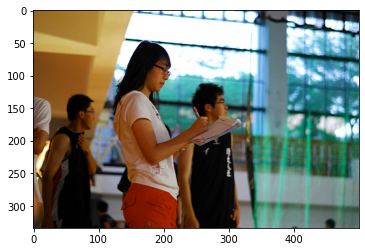

Real Caption: woman wearing white shirt and red pants is writing something down at museum
Predicted Caption: the man in the black shirt is standing next to the lady in the black top
BLEU-1 score: 12.500000000000004
BLEU-2 score: 5.273843307431706e-153
BLEU-3 score: 1.372396692566494e-183
BLEU-4 score: 1.0832677820940878e-229


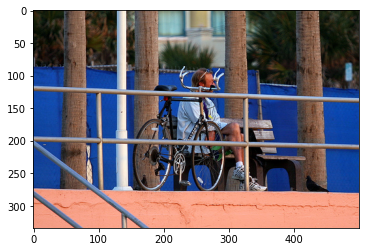

Real Caption: man sitting on bench with his bicycle leaning against railing
Predicted Caption: man sits on bench next to bike
BLEU-1 score: 27.91881675133095
BLEU-2 score: 17.410441154600917
BLEU-3 score: 1.493615157227752e-91
BLEU-4 score: 5.023587836914362e-153


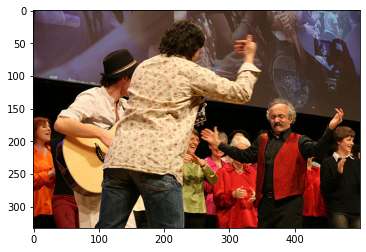

Real Caption: the man is playing the acoustic guitar while the other men make gestures
Predicted Caption: group of people performing
BLEU-1 score: 0
BLEU-2 score: 0
BLEU-3 score: 0
BLEU-4 score: 0


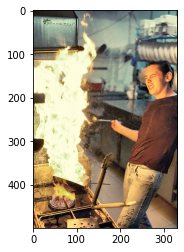

Real Caption: woman at stove jumps back from the high flames of pan
Predicted Caption: cook steps back as flames leap from pan in kitchen
BLEU-1 score: 36.193496721438386
BLEU-2 score: 8.536360807345964e-153
BLEU-3 score: 1.760334530221513e-183
BLEU-4 score: 1.3109733799909448e-229


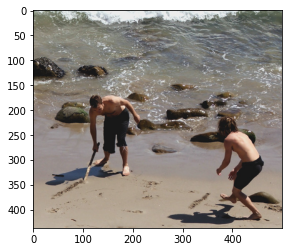

Real Caption: two men writing in the sand on rocky beach
Predicted Caption: the children are playing in the sand at rocky beach
BLEU-1 score: 50.0
BLEU-2 score: 40.8248290463863
BLEU-3 score: 31.306003451477082
BLEU-4 score: 4.640083527732319e-76


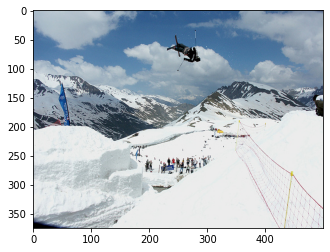

Real Caption: the skier does flip
Predicted Caption: skier doing flip while jumping
BLEU-1 score: 40.0
BLEU-2 score: 9.434137710479516e-153
BLEU-3 score: 1.9454705288851736e-183
BLEU-4 score: 1.4488496539373276e-229


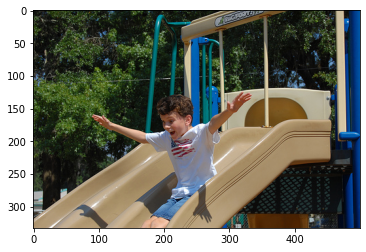

Real Caption: the kid is sliding down tan plastic slide
Predicted Caption: boy on the top of slide with his arms flung out
BLEU-1 score: 18.181818181818183
BLEU-2 score: 6.360494346864464e-153
BLEU-3 score: 1.5356698295026469e-183
BLEU-4 score: 1.1896457329133972e-229


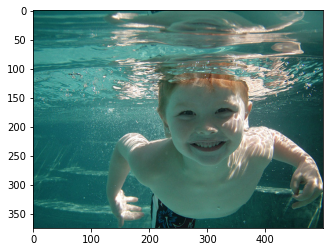

Real Caption: the boys smiles underwater at the pool
Predicted Caption: small boy wearing black and white shirt is being held by the hands over the water
BLEU-1 score: 12.500000000000004
BLEU-2 score: 5.273843307431706e-153
BLEU-3 score: 1.372396692566494e-183
BLEU-4 score: 1.0832677820940878e-229


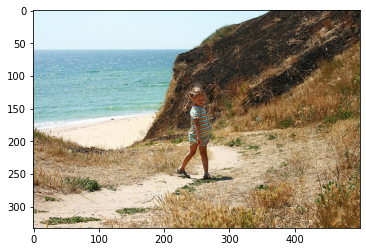

Real Caption: young girl stands on the sand by shore
Predicted Caption: blonde child stands in beach
BLEU-1 score: 10.976232721880528
BLEU-2 score: 3.6610910047675876e-153
BLEU-3 score: 8.672393363093234e-184
BLEU-4 score: 6.686350417856737e-230


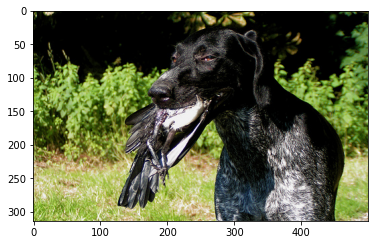

Real Caption: black dog retrieves bird
Predicted Caption: black dog with white toy in his mouth is running
BLEU-1 score: 20.0
BLEU-2 score: 14.9071198499986
BLEU-3 score: 1.6152493512830776e-91
BLEU-4 score: 5.75929185611095e-153


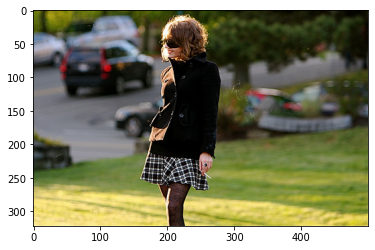

Real Caption: thin girl in black smokes cigarette
Predicted Caption: man in black shirt is holding paper bottle while sitting on the shoulders of person on him with the side of the side of the ball her water fountain
BLEU-1 score: 6.896551724137931
BLEU-2 score: 4.962916669854652
BLEU-3 score: 8.349212590527404e-92
BLEU-4 score: 3.323079316544124e-153


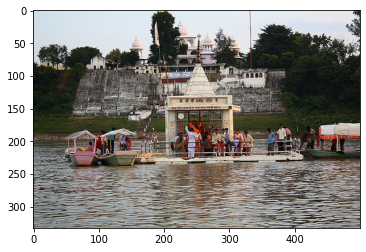

Real Caption: people are gathered on platform in water for ceremony
Predicted Caption: group of people are standing next to boats
BLEU-1 score: 22.062422564614888
BLEU-2 score: 16.677623835883093
BLEU-3 score: 1.6434977345885395e-91
BLEU-4 score: 5.722633035689358e-153


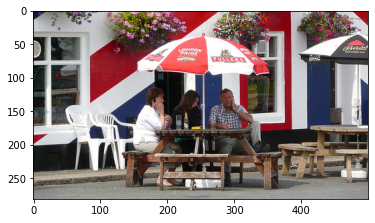

Real Caption: three people sit at an outdoor cafe
Predicted Caption: woman in knit uniform sits with man on park bench
BLEU-1 score: 0
BLEU-2 score: 0
BLEU-3 score: 0
BLEU-4 score: 0


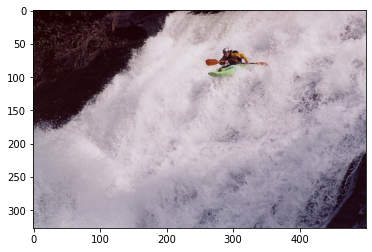

Real Caption: white water rafter goes through rough spot
Predicted Caption: kayaker falling down waterfall
BLEU-1 score: 0
BLEU-2 score: 0
BLEU-3 score: 0
BLEU-4 score: 0


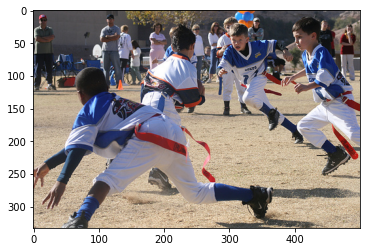

Real Caption: young boys play touch football
Predicted Caption: group of men play flag in baseball game
BLEU-1 score: 12.500000000000004
BLEU-2 score: 5.273843307431706e-153
BLEU-3 score: 1.372396692566494e-183
BLEU-4 score: 1.0832677820940878e-229


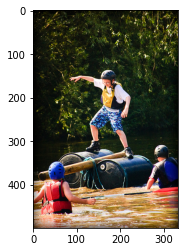

Real Caption: there are two children in the water and one balancing on float and they are all wearing helmets
Predicted Caption: girl with her feet in the air above her head of water raft
BLEU-1 score: 15.708747653616587
BLEU-2 score: 9.439782523073205
BLEU-3 score: 1.0528487531260733e-91
BLEU-4 score: 3.7812469405437094e-153


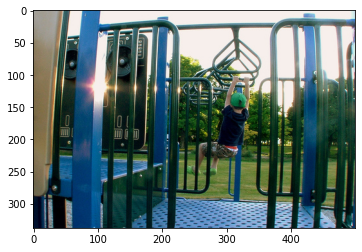

Real Caption: kids playing at park jungle gym
Predicted Caption: child playing on playground play set
BLEU-1 score: 16.666666666666668
BLEU-2 score: 6.08970970641905e-153
BLEU-3 score: 1.4961022763680928e-183
BLEU-4 score: 1.1640469867513693e-229


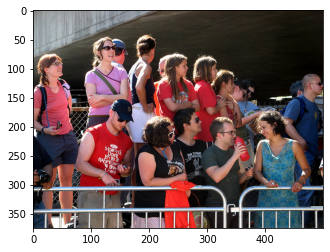

Real Caption: crowd of people are standing behind railing watching something in the distance
Predicted Caption: group of people are on boat in the middle of the road
BLEU-1 score: 41.66666666666667
BLEU-2 score: 33.7099931231621
BLEU-3 score: 26.10088290788024
BLEU-4 score: 3.9876353728947066e-76


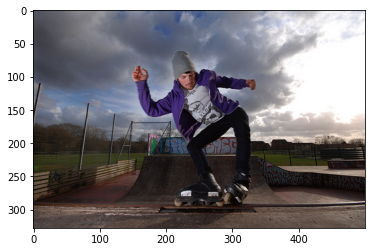

Real Caption: an inline skater wearing purple jacket is performing trick on ramp
Predicted Caption: man in grey winter hat and purple sweatshirt skateboarding
BLEU-1 score: 8.897082254631197
BLEU-2 score: 3.981448258113331e-153
BLEU-3 score: 1.0607768203596798e-183
BLEU-4 score: 8.42243777956461e-230


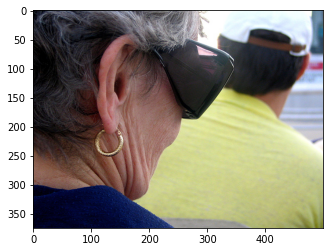

Real Caption: an old lady wearing sunglasses is sitting behind man in yellow
Predicted Caption: girl in blue sweater sits in man in yellow shirt
BLEU-1 score: 27.145122541078788
BLEU-2 score: 23.36280167385726
BLEU-3 score: 21.518707286373346
BLEU-4 score: 3.338961013437553e-76


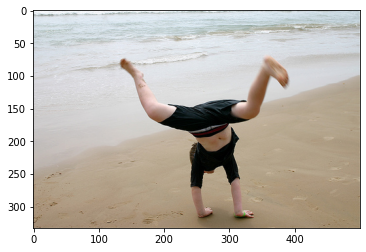

Real Caption: person with black shorts and shirt does handstand on the beach
Predicted Caption: the male is doing handstand on the wet sand at the edge of the ocean
BLEU-1 score: 20.0
BLEU-2 score: 16.90308509457033
BLEU-3 score: 15.943974129164024
BLEU-4 score: 2.6444372049983824e-76


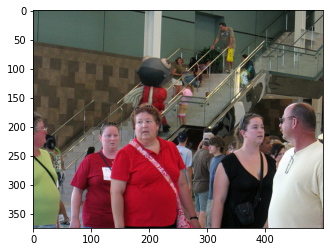

Real Caption: woman in red shirt stands by man in white shirt and woman in black shirt in front of stairway
Predicted Caption: group of people waiting for game outside
BLEU-1 score: 2.5727473163993193
BLEU-2 score: 1.0153560702790748e-153
BLEU-3 score: 2.5726009206545887e-184
BLEU-4 score: 2.0171072364516604e-230


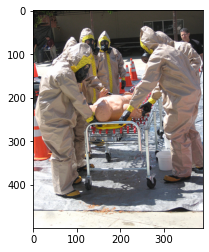

Real Caption: there is man on stretcher surrounded by men in hazmat suits
Predicted Caption: group of people are looking at an airport
BLEU-1 score: 0
BLEU-2 score: 0
BLEU-3 score: 0
BLEU-4 score: 0


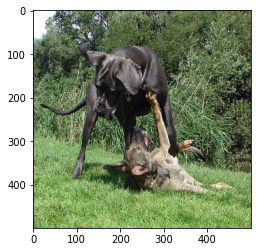

Real Caption: two dogs are wrestling in grassy field
Predicted Caption: dog is playing with large black and brown dog
BLEU-1 score: 0
BLEU-2 score: 0
BLEU-3 score: 0
BLEU-4 score: 0


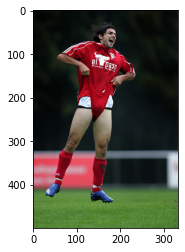

Real Caption: male soccer player wearing red uniform jumping in the air and pulling up his shorts
Predicted Caption: man in red sports uniform and blue shoes jumping and pull up legs of shorts
BLEU-1 score: 46.666666666666664
BLEU-2 score: 1.0190033369114728e-152
BLEU-3 score: 2.037551962603461e-183
BLEU-4 score: 1.5057747795382669e-229


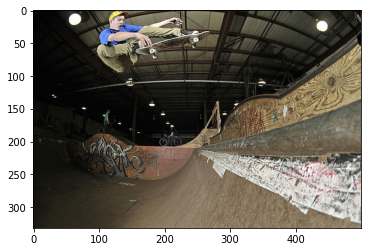

Real Caption: male skateboarder takes <unk> of the half pipe
Predicted Caption: skateboarder doing jump in half pipe
BLEU-1 score: 35.826565528689464
BLEU-2 score: 22.65870956238665
BLEU-3 score: 1.8173496937128004e-91
BLEU-4 score: 6.0104555320873e-153


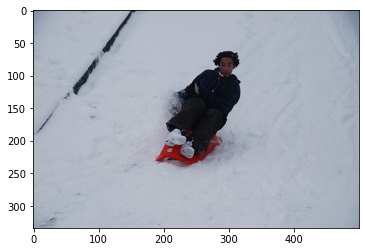

Real Caption: the young boy sleds down the hill in the snow
Predicted Caption: man in blue jacket is riding red sledge down snowy hill
BLEU-1 score: 27.27272727272727
BLEU-2 score: 7.789982830837433e-153
BLEU-3 score: 1.7343040158223243e-183
BLEU-4 score: 1.3165594234639305e-229


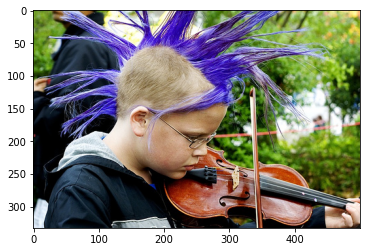

Real Caption: boy with purple spiky mohawk plays violin
Predicted Caption: boy wearing blue shirt is playing the violin
BLEU-1 score: 25.0
BLEU-2 score: 7.458340731200295e-153
BLEU-3 score: 1.6896185209462902e-183
BLEU-4 score: 1.2882297539194153e-229


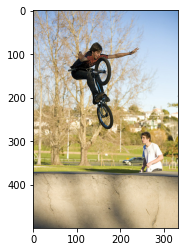

Real Caption: boy doing trick on bike
Predicted Caption: bicyclist is jumping over large object
BLEU-1 score: 0
BLEU-2 score: 0
BLEU-3 score: 0
BLEU-4 score: 0


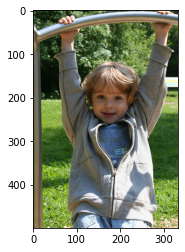

Real Caption: happy child dangling from playground equipment smiles at the camera
Predicted Caption: child in green shirt is playing on playground
BLEU-1 score: 19.470019576785123
BLEU-2 score: 5.808561601872144e-153
BLEU-3 score: 1.3158762272049197e-183
BLEU-4 score: 1.0032743411283238e-229


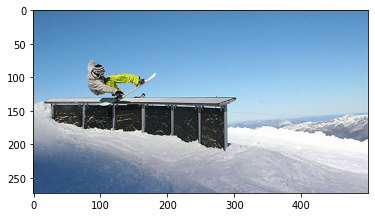

Real Caption: the man is performing trick on snowboard high in the air
Predicted Caption: someone in yellow pants is on ramp over the snow
BLEU-1 score: 36.193496721438386
BLEU-2 score: 8.536360807345964e-153
BLEU-3 score: 1.760334530221513e-183
BLEU-4 score: 1.3109733799909448e-229


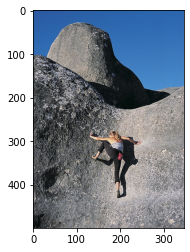

Real Caption: lady in black pants and her shadow climb large rocks
Predicted Caption: girl in purple top is rock climbing
BLEU-1 score: 9.306272250443651
BLEU-2 score: 3.672797542504966e-153
BLEU-3 score: 9.305742700321069e-184
BLEU-4 score: 7.296382734947758e-230


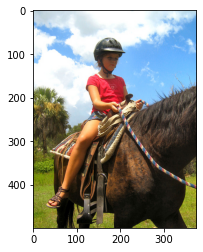

Real Caption: girl with black helmet riding brown <unk> horse
Predicted Caption: the brown horse is holding onto the horses while wearing helmet
BLEU-1 score: 27.27272727272727
BLEU-2 score: 7.789982830837433e-153
BLEU-3 score: 1.7343040158223243e-183
BLEU-4 score: 1.3165594234639305e-229


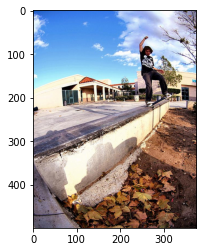

Real Caption: skateboarder attempts trick on the side of low wall
Predicted Caption: boy wearing white shirt and blue jeans is skateboarding on ramp
BLEU-1 score: 9.09090909090909
BLEU-2 score: 4.497548684366688e-153
BLEU-3 score: 1.2473514990254889e-183
BLEU-4 score: 1.0003688322288243e-229


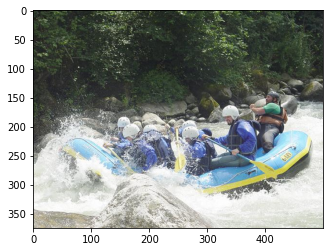

Real Caption: group of people are in large raft on choppy water
Predicted Caption: group of people in blue raft white water rafting
BLEU-1 score: 59.655954454291305
BLEU-2 score: 36.53166213293175
BLEU-3 score: 29.158841853453737
BLEU-4 score: 4.29307862935549e-76


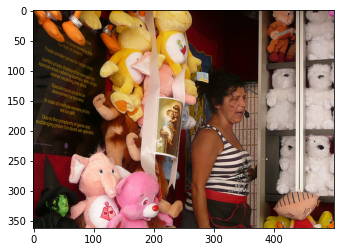

Real Caption: woman wearing black and white striped shirt standing amongst stuffed animals hanging and on shelf
Predicted Caption: three women one child wearing hat green striped shirt is playing bagpipe or
BLEU-1 score: 19.786244288317878
BLEU-2 score: 11.890053055064433
BLEU-3 score: 1.3261351628630489e-91
BLEU-4 score: 4.762739674083922e-153


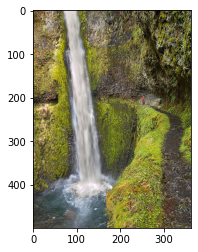

Real Caption: beautiful waterfall flows down the side of mossy rock wall
Predicted Caption: beautiful waterfall with two people walking on the road beside it
BLEU-1 score: 27.27272727272727
BLEU-2 score: 16.514456476895408
BLEU-3 score: 1.7175994813661398e-91
BLEU-4 score: 6.061838450024688e-153


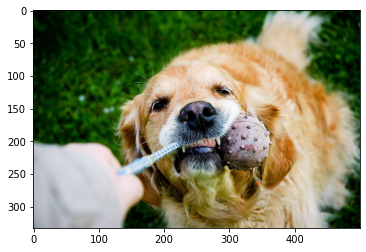

Real Caption: dog bites an object <unk> by person
Predicted Caption: dog playing with dog toy as someone tries to grab it
BLEU-1 score: 9.09090909090909
BLEU-2 score: 4.497548684366688e-153
BLEU-3 score: 1.2473514990254889e-183
BLEU-4 score: 1.0003688322288243e-229


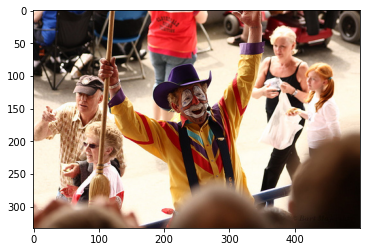

Real Caption: man dressed as clown is performing before and audience
Predicted Caption: the man in the blue shirt is standing in crowd
BLEU-1 score: 20.0
BLEU-2 score: 6.6709427497276e-153
BLEU-3 score: 1.5802130991274055e-183
BLEU-4 score: 1.2183324802375697e-229


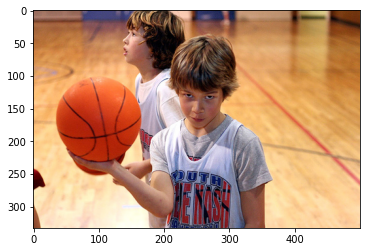

Real Caption: boy with basketballs <unk> at the camera
Predicted Caption: boy holds basketball
BLEU-1 score: 8.786571270524224
BLEU-2 score: 2.2701381082415207e-153
BLEU-3 score: 4.855243027268271e-184
BLEU-4 score: 3.648956622645728e-230


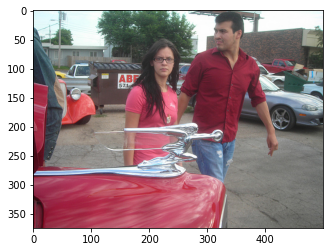

Real Caption: couple in parking lot
Predicted Caption: man and woman walking next to red car with an unusual hood ornament
BLEU-1 score: 0
BLEU-2 score: 0
BLEU-3 score: 0
BLEU-4 score: 0


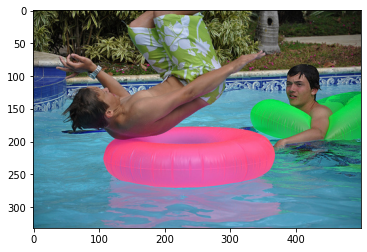

Real Caption: two boys <unk> around in pool with inflatable <unk>
Predicted Caption: two guys are in pool and one is falling down
BLEU-1 score: 30.0
BLEU-2 score: 18.257418583505533
BLEU-3 score: 1.8241769048702254e-91
BLEU-4 score: 6.373704167435468e-153


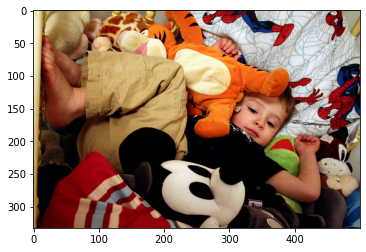

Real Caption: child laying in the midst of stuffed toys and blankets
Predicted Caption: young boy in helmet and blue jacket playing on toy
BLEU-1 score: 20.0
BLEU-2 score: 6.6709427497276e-153
BLEU-3 score: 1.5802130991274055e-183
BLEU-4 score: 1.2183324802375697e-229


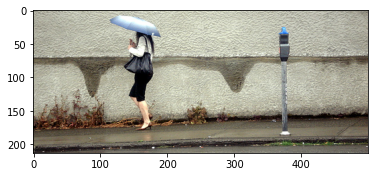

Real Caption: woman is walking down the street holding an umbrella
Predicted Caption: man walking in the street under lounge bar
BLEU-1 score: 33.09363384692233
BLEU-2 score: 20.42583425999594
BLEU-3 score: 1.8560791299878595e-91
BLEU-4 score: 6.33313451367699e-153


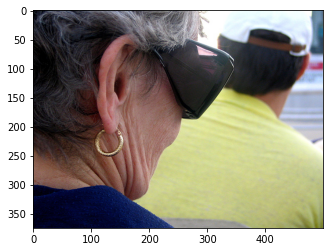

Real Caption: an older woman with big sunglasses sits behind man in yellow shirt perhaps at ball game or other event
Predicted Caption: girl in blue sweater sits in man in yellow shirt
BLEU-1 score: 20.328482987029957
BLEU-2 score: 16.59813685435741
BLEU-3 score: 15.67009371496248
BLEU-4 score: 11.292956255471857


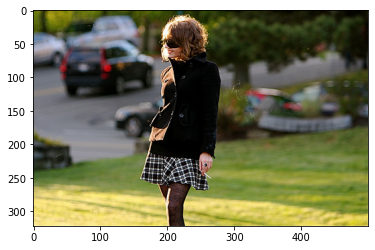

Real Caption: the woman in the black coat is standing with cigarette in her hand
Predicted Caption: man in black shirt is holding paper bottle while sitting on the shoulders of person on him with the side of the side of the ball her water fountain
BLEU-1 score: 24.137931034482758
BLEU-2 score: 7.328620562102969e-153
BLEU-3 score: 1.6719245369831186e-183
BLEU-4 score: 1.2769777614215993e-229


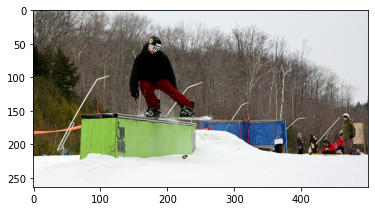

Real Caption: man is sliding along green barrier on his snowboard
Predicted Caption: snowboarder goes up ramp
BLEU-1 score: 0
BLEU-2 score: 0
BLEU-3 score: 0
BLEU-4 score: 0


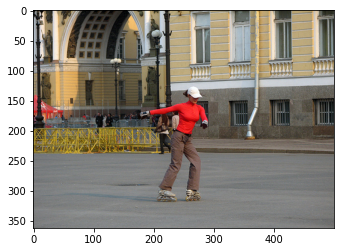

Real Caption: girl in red shirt and brown pants is skating
Predicted Caption: woman in red jacket and white cap rollerblading on grey surface
BLEU-1 score: 27.27272727272727
BLEU-2 score: 16.514456476895408
BLEU-3 score: 1.7175994813661398e-91
BLEU-4 score: 6.061838450024688e-153


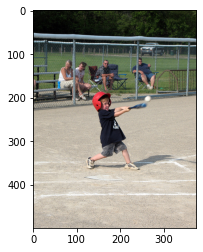

Real Caption: child hits baseball
Predicted Caption: little boy hits baseball while his family watches
BLEU-1 score: 25.0
BLEU-2 score: 18.898223650461357
BLEU-3 score: 1.8623269155678368e-91
BLEU-4 score: 6.484592771860511e-153


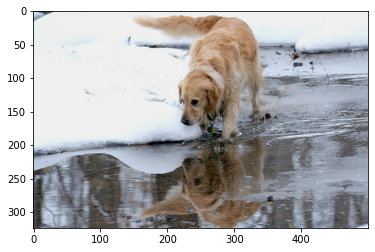

Real Caption: brown dog at the edge of body of water surrounded by snow
Predicted Caption: dog swimming in the water
BLEU-1 score: 14.795817836496388
BLEU-2 score: 2.84928286431758e-153
BLEU-3 score: 5.418009463852912e-184
BLEU-4 score: 3.953974475947138e-230


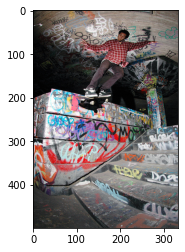

Real Caption: man does skating trick off of stairs
Predicted Caption: man does skateboard trick on cement monument over front of colorful structure
BLEU-1 score: 33.33333333333333
BLEU-2 score: 17.407765595569778
BLEU-3 score: 1.7727567490939188e-91
BLEU-4 score: 6.223629500679345e-153


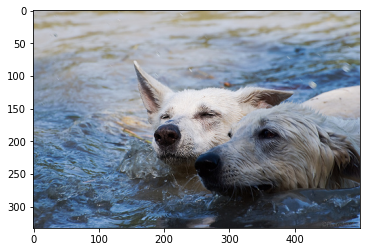

Real Caption: white dog in the water
Predicted Caption: two white dogs are swimming
BLEU-1 score: 20.0
BLEU-2 score: 6.6709427497276e-153
BLEU-3 score: 1.5802130991274055e-183
BLEU-4 score: 1.2183324802375697e-229


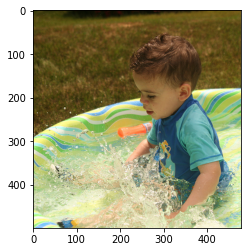

Real Caption: young child splashes in green and yellow wading pool
Predicted Caption: boy in blue shirt plays in the kiddie pool
BLEU-1 score: 22.22222222222222
BLEU-2 score: 7.031791076575252e-153
BLEU-3 score: 1.6309584783156365e-183
BLEU-4 score: 1.2508498911928378e-229


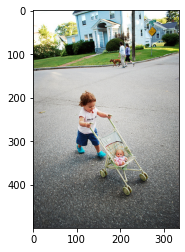

Real Caption: little kid in blue shoes is pushing toy baby in stroller
Predicted Caption: the child has an sign that is on leash of bike
BLEU-1 score: 9.09090909090909
BLEU-2 score: 4.497548684366688e-153
BLEU-3 score: 1.2473514990254889e-183
BLEU-4 score: 1.0003688322288243e-229


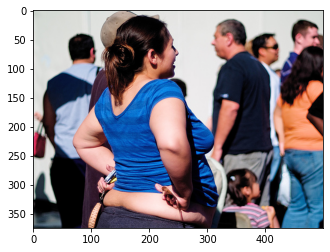

Real Caption: woman wearing shirt that has <unk> up from the waist of her jeans
Predicted Caption: woman in blue shirt in crowd
BLEU-1 score: 10.380107463819924
BLEU-2 score: 2.6818512928142403e-153
BLEU-3 score: 5.735791907256696e-184
BLEU-4 score: 4.3107329022575925e-230


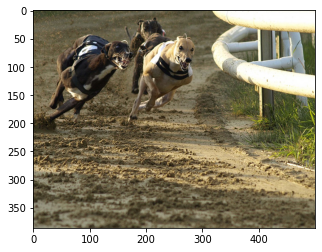

Real Caption: three dogs running on racetrack
Predicted Caption: two dogs run around dog on track
BLEU-1 score: 28.57142857142857
BLEU-2 score: 7.973301625706313e-153
BLEU-3 score: 1.7586776545063734e-183
BLEU-4 score: 1.331960397810445e-229


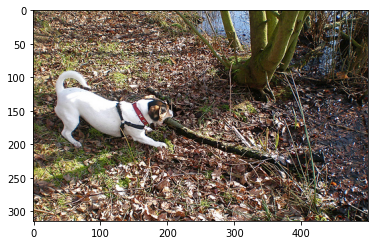

Real Caption: small white dog pulls large stick out of the water
Predicted Caption: white dog is licking fallen tree
BLEU-1 score: 17.113903967753068
BLEU-2 score: 13.256373011140136
BLEU-3 score: 1.1530451067989366e-91
BLEU-4 score: 3.8915242969889024e-153


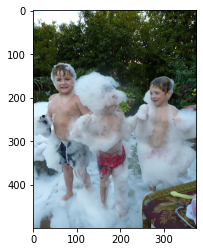

Real Caption: three little boys cover themselves with bubbles
Predicted Caption: three children in bathing suits are playing in foam
BLEU-1 score: 11.111111111111109
BLEU-2 score: 4.972227154133551e-153
BLEU-3 score: 1.3247499323693867e-183
BLEU-4 score: 1.0518351895246306e-229


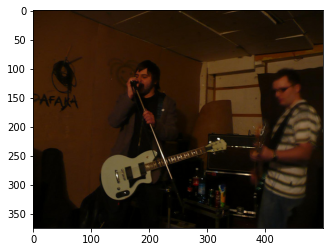

Real Caption: two men performing each playing guitars while one is singing
Predicted Caption: two men are playing in band
BLEU-1 score: 25.6708559516296
BLEU-2 score: 16.23567485864776
BLEU-3 score: 1.3021879578069072e-91
BLEU-4 score: 4.3066795795519947e-153


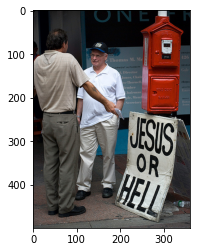

Real Caption: two men talking by red box and poster
Predicted Caption: two men are talking on the street one is pointing at sign that says jesus or hell beneath red box and the other is standing there listening
BLEU-1 score: 22.22222222222222
BLEU-2 score: 16.012815380508712
BLEU-3 score: 12.685237866751779
BLEU-4 score: 2.1856718250793203e-76


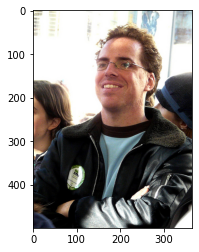

Real Caption: man in blue shirt black jacket and glasses smiling with his arms crossed
Predicted Caption: man in black and white cap and glasses
BLEU-1 score: 33.453839282436896
BLEU-2 score: 22.618923685244415
BLEU-3 score: 1.6155219760581522e-91
BLEU-4 score: 5.190284426706259e-153


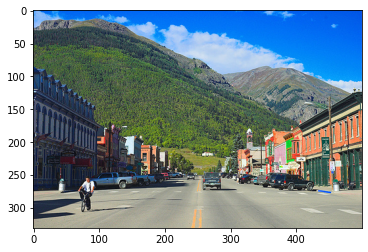

Real Caption: town at the foothills of mountain is seen <unk> with <unk> daytime activity
Predicted Caption: car is driving towards green mountain
BLEU-1 score: 10.380107463819924
BLEU-2 score: 2.6818512928142403e-153
BLEU-3 score: 5.735791907256696e-184
BLEU-4 score: 4.3107329022575925e-230


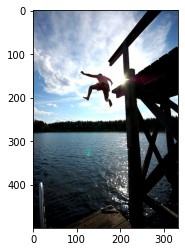

Real Caption: person jumping off dock into water
Predicted Caption: lone skateboarder jumping into the air into lake
BLEU-1 score: 25.0
BLEU-2 score: 7.458340731200295e-153
BLEU-3 score: 1.6896185209462902e-183
BLEU-4 score: 1.2882297539194153e-229


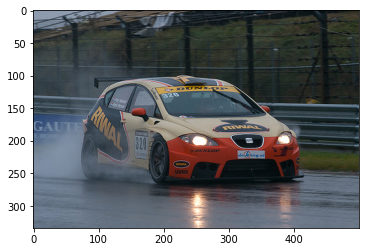

Real Caption: racing car is driving around wet track with its headlights on
Predicted Caption: flaming are racing around bend in the track
BLEU-1 score: 25.773347954661457
BLEU-2 score: 6.278088288256672e-153
BLEU-3 score: 1.3114616894303907e-183
BLEU-4 score: 9.798412298238562e-230


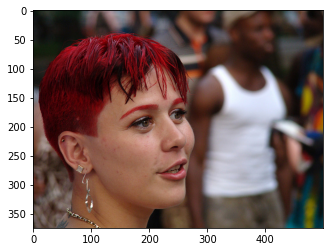

Real Caption: closeup of woman with short red hair
Predicted Caption: young girl in costume with black pen in her face
BLEU-1 score: 10.000000000000002
BLEU-2 score: 4.717068855239749e-153
BLEU-3 score: 1.2835318765197404e-183
BLEU-4 score: 1.0244914152188952e-229


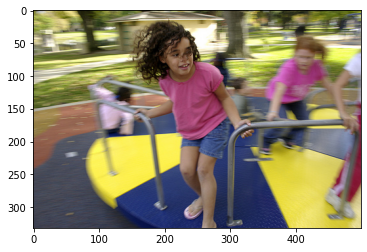

Real Caption: children in summer clothes play on <unk> in park
Predicted Caption: two girls are playing at playground
BLEU-1 score: 0
BLEU-2 score: 0
BLEU-3 score: 0
BLEU-4 score: 0


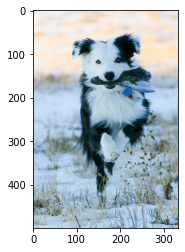

Real Caption: black and white dog returns stick in the snow
Predicted Caption: playful dog running across the snowy field with stick in its mouth
BLEU-1 score: 33.33333333333333
BLEU-2 score: 17.407765595569778
BLEU-3 score: 1.7727567490939188e-91
BLEU-4 score: 6.223629500679345e-153


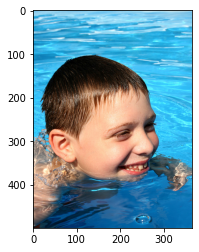

Real Caption: boy smiles and swims in blue water
Predicted Caption: smiling boy swims with only his head above the water
BLEU-1 score: 30.0
BLEU-2 score: 8.170202920075766e-153
BLEU-3 score: 1.7846088208682726e-183
BLEU-4 score: 1.3483065280626045e-229


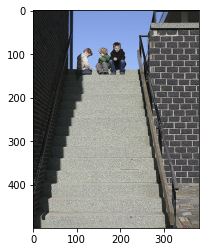

Real Caption: three children are sitting at the top of flight of steps
Predicted Caption: three small boys sit at the top of stairs surrounded by brick walls
BLEU-1 score: 38.46153846153847
BLEU-2 score: 31.008683647302114
BLEU-3 score: 29.701692076911158
BLEU-4 score: 20.44800736021839


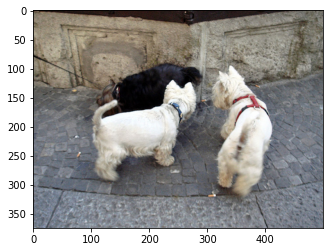

Real Caption: three dogs looking at cement ledge
Predicted Caption: two white dogs are playing with soccer ball on wooden floor near the street
BLEU-1 score: 7.1428571428571415
BLEU-2 score: 3.986650812853149e-153
BLEU-3 score: 1.1602945388103906e-183
BLEU-4 score: 9.418382295637229e-230


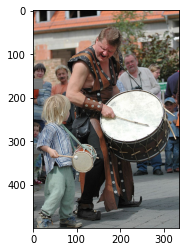

Real Caption: the small child bangs his drum <unk> looking at an older man doing the same
Predicted Caption: the man in the blue shirt is playing the drum
BLEU-1 score: 24.26122638850534
BLEU-2 score: 5.722093769356974e-153
BLEU-3 score: 1.1799875233362102e-183
BLEU-4 score: 8.787717364270279e-230


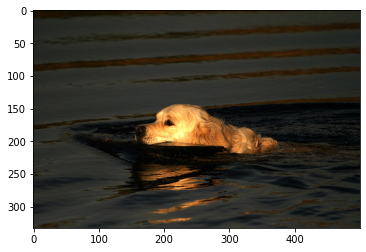

Real Caption: dog swimming in lake has sunshine shining on him
Predicted Caption: golden dog swims with stick in its mouth
BLEU-1 score: 22.062422564614888
BLEU-2 score: 6.581962593704787e-153
BLEU-3 score: 1.4910831112846667e-183
BLEU-4 score: 1.1368587676511997e-229


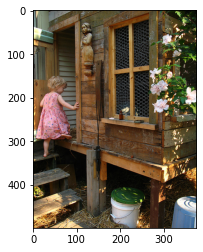

Real Caption: little girl climbing into wooden playhouse
Predicted Caption: girl going into wooden building
BLEU-1 score: 49.12384518467891
BLEU-2 score: 31.709305716988812
BLEU-3 score: 2.3451563965552024e-91
BLEU-4 score: 7.600394483915427e-153


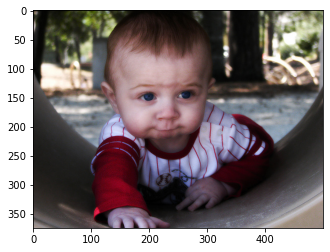

Real Caption: baby smiling for the camera
Predicted Caption: young boy wearing striped shirt eats large metal bowl
BLEU-1 score: 0
BLEU-2 score: 0
BLEU-3 score: 0
BLEU-4 score: 0


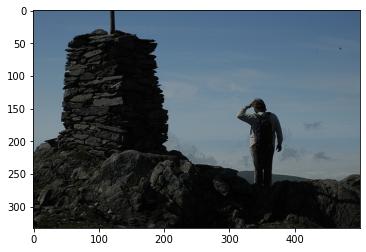

Real Caption: person <unk> their eyes standing beside tower of flat stone
Predicted Caption: man puts his hand to his head on rock wall
BLEU-1 score: 0
BLEU-2 score: 0
BLEU-3 score: 0
BLEU-4 score: 0


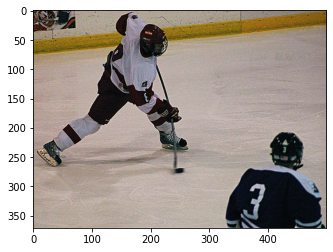

Real Caption: hockey player wearing black and white slides his stick along the ice
Predicted Caption: two men are playing game together on the ice
BLEU-1 score: 15.922918012750872
BLEU-2 score: 11.942188509563156
BLEU-3 score: 1.2375072498359727e-91
BLEU-4 score: 4.3634676769543673e-153


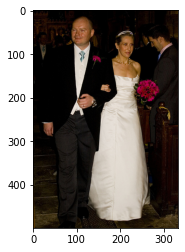

Real Caption: the man is walking the bride down the aisle
Predicted Caption: man in white suit and woman in black suit smile
BLEU-1 score: 10.000000000000002
BLEU-2 score: 4.717068855239749e-153
BLEU-3 score: 1.2835318765197404e-183
BLEU-4 score: 1.0244914152188952e-229


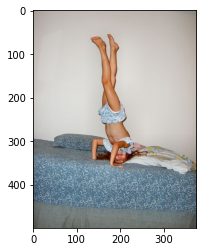

Real Caption: small child doing handstand on bed
Predicted Caption: girl bounces on bed with blue sheets
BLEU-1 score: 28.57142857142857
BLEU-2 score: 21.82178902359924
BLEU-3 score: 2.030194004994321e-91
BLEU-4 score: 6.968148412761693e-153


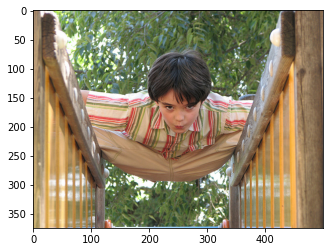

Real Caption: boy in striped shirt straddles two railings
Predicted Caption: young blond girl wearing green shirt and overalls stands at table
BLEU-1 score: 9.09090909090909
BLEU-2 score: 4.497548684366688e-153
BLEU-3 score: 1.2473514990254889e-183
BLEU-4 score: 1.0003688322288243e-229


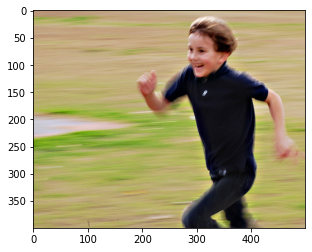

Real Caption: young boy in dark clothing with smile sprints
Predicted Caption: boy in blue shirt runs through the grass
BLEU-1 score: 25.0
BLEU-2 score: 18.898223650461357
BLEU-3 score: 1.8623269155678368e-91
BLEU-4 score: 6.484592771860511e-153


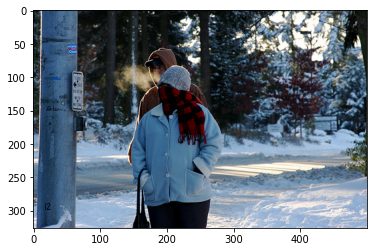

Real Caption: couple dressed in coats hats and scarves are standing in the snow
Predicted Caption: two people wearing winter clothes stand near pole in winter scene
BLEU-1 score: 8.300915602566022
BLEU-2 score: 4.1067149252095696e-153
BLEU-3 score: 1.1389575472159276e-183
BLEU-4 score: 9.1343749725459e-230


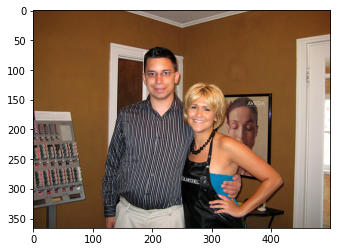

Real Caption: man is standing next to woman with his arm around her waist
Predicted Caption: man is playing guitar with woman
BLEU-1 score: 24.525296078096154
BLEU-2 score: 13.433057891466246
BLEU-3 score: 1.0171627996810396e-91
BLEU-4 score: 3.3159839357976687e-153


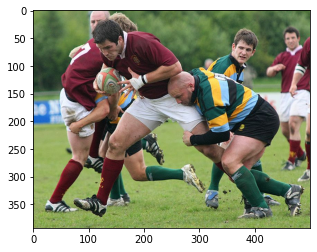

Real Caption: soccer player in red being tackled by soccer player in green
Predicted Caption: group of soccer players in action
BLEU-1 score: 14.486606950235942
BLEU-2 score: 3.742824986484746e-153
BLEU-3 score: 8.004942453475685e-184
BLEU-4 score: 6.016112399618114e-230


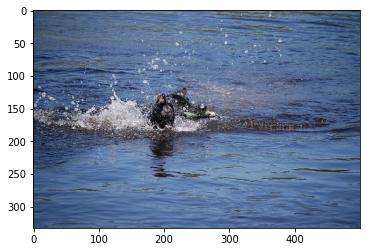

Real Caption: dark colored animal splashes in the water
Predicted Caption: dog swims through water with stick in its mouth
BLEU-1 score: 22.22222222222222
BLEU-2 score: 7.031791076575252e-153
BLEU-3 score: 1.6309584783156365e-183
BLEU-4 score: 1.2508498911928378e-229


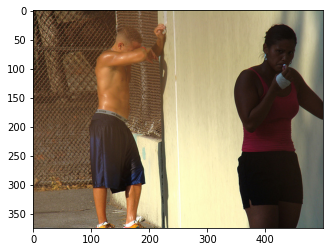

Real Caption: two people stand against wall after workout
Predicted Caption: man and woman resting after exercise
BLEU-1 score: 14.108028748176901
BLEU-2 score: 5.154827976372712e-153
BLEU-3 score: 1.2664232355128374e-183
BLEU-4 score: 9.853445011990207e-230


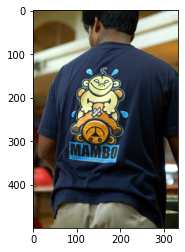

Real Caption: man wears showing baby humping stuffed bear
Predicted Caption: the man in the blue shirt is wearing rope with blurry nearby
BLEU-1 score: 8.333333333333332
BLEU-2 score: 4.306075028866568e-153
BLEU-3 score: 1.2152126591739945e-183
BLEU-4 score: 9.788429383461836e-230


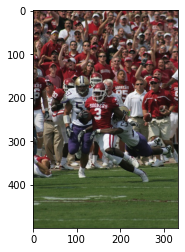

Real Caption: football player in red being tackled by opponents in white
Predicted Caption: football player in sooners jersey runs down field with large crowd in the background
BLEU-1 score: 28.57142857142857
BLEU-2 score: 20.965696734438367
BLEU-3 score: 18.584513891213202
BLEU-4 score: 3.0046607657263396e-76


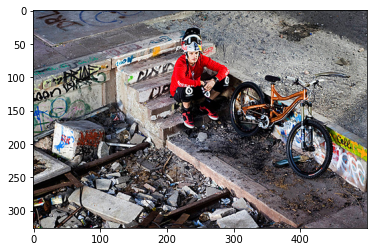

Real Caption: helmeted man sits on steps with graffiti on them and bike nearby
Predicted Caption: man sits on the stairs next to his bike
BLEU-1 score: 31.845836025501743
BLEU-2 score: 23.884377019126312
BLEU-3 score: 20.674404440962387
BLEU-4 score: 3.106248119711438e-76


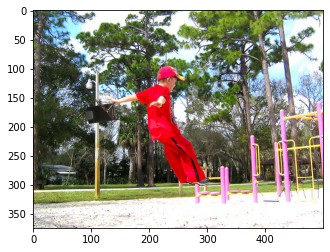

Real Caption: young boy in red leaping into sand at playground
Predicted Caption: child in red pants jumping into sandbox
BLEU-1 score: 32.206169703226536
BLEU-2 score: 20.084075461628778
BLEU-3 score: 1.7229821612226873e-91
BLEU-4 score: 5.795035077445241e-153


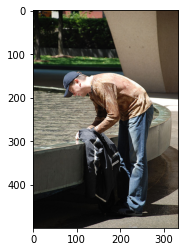

Real Caption: man in brown jacket and blue cap is washing black jacket in fountain
Predicted Caption: man washing the corner of jacket in public fountain
BLEU-1 score: 35.62113269055304
BLEU-2 score: 16.896586820584414
BLEU-3 score: 1.4577223485346987e-91
BLEU-4 score: 4.909777631374571e-153


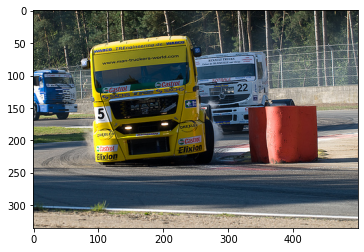

Real Caption: trucks race in an obstacle course
Predicted Caption: black car drives on track while several people watch from behind rope
BLEU-1 score: 0
BLEU-2 score: 0
BLEU-3 score: 0
BLEU-4 score: 0


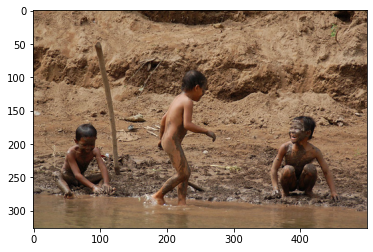

Real Caption: three boys playing in the mud
Predicted Caption: three children in rural area playing in muddy water
BLEU-1 score: 33.33333333333333
BLEU-2 score: 20.412414523193153
BLEU-3 score: 1.9504730631920925e-91
BLEU-4 score: 6.7393716283177e-153


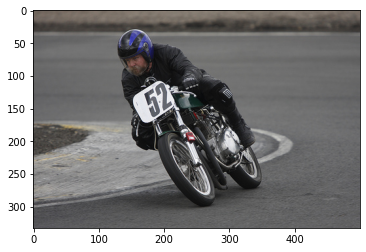

Real Caption: motorcyclist on number bike leans in for sharp turn
Predicted Caption: man in blue shirt and black helmet riding motorcycle
BLEU-1 score: 11.111111111111109
BLEU-2 score: 4.972227154133551e-153
BLEU-3 score: 1.3247499323693867e-183
BLEU-4 score: 1.0518351895246306e-229


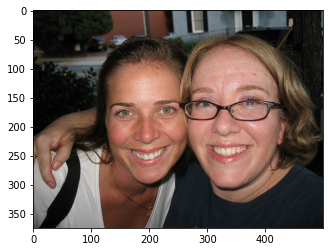

Real Caption: two <unk> smiling
Predicted Caption: two women sharing drink taking blurred photo of their faces
BLEU-1 score: 10.000000000000002
BLEU-2 score: 4.717068855239749e-153
BLEU-3 score: 1.2835318765197404e-183
BLEU-4 score: 1.0244914152188952e-229


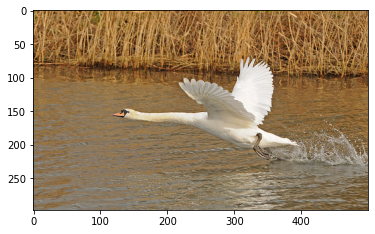

Real Caption: the white swan is taking off from the water
Predicted Caption: white bird flying above water
BLEU-1 score: 17.973158564688863
BLEU-2 score: 4.239031324788977e-153
BLEU-3 score: 8.741562574645582e-184
BLEU-4 score: 6.510101141652544e-230


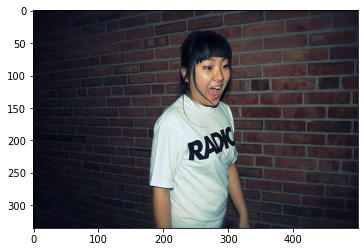

Real Caption: an asian girl makes surprised face while wearing shirt that says radio
Predicted Caption: young girl wearing dress stands near the door and holds up to her right
BLEU-1 score: 14.285714285714285
BLEU-2 score: 5.637975647982814e-153
BLEU-3 score: 1.4284901392909564e-183
BLEU-4 score: 1.1200407237786664e-229


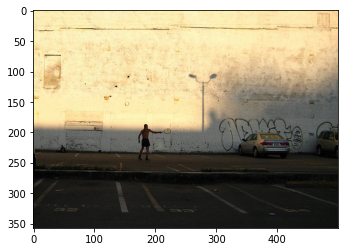

Real Caption: man in the near distance is pointing to silver <unk> near him
Predicted Caption: man walks toward car in parking lot
BLEU-1 score: 13.986904558770089
BLEU-2 score: 3.9032633099964214e-153
BLEU-3 score: 8.6094597761278e-184
BLEU-4 score: 6.520501036082648e-230


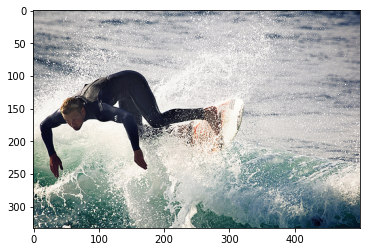

Real Caption: man on surfboard dives over large wave
Predicted Caption: man in wetsuit is surfing on blue water
BLEU-1 score: 25.0
BLEU-2 score: 7.458340731200295e-153
BLEU-3 score: 1.6896185209462902e-183
BLEU-4 score: 1.2882297539194153e-229


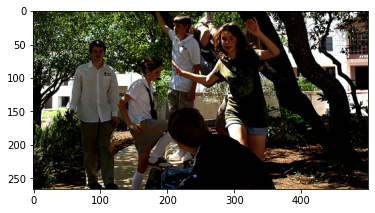

Real Caption: teenagers socializing in the shade
Predicted Caption: group of people stand outside in the snow
BLEU-1 score: 25.0
BLEU-2 score: 18.898223650461357
BLEU-3 score: 1.8623269155678368e-91
BLEU-4 score: 6.484592771860511e-153


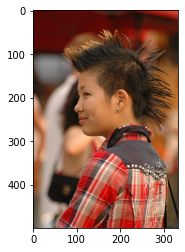

Real Caption: person with spiky hair looks to the left
Predicted Caption: the child has black and yellow face paint on and is holding his nose
BLEU-1 score: 7.1428571428571415
BLEU-2 score: 3.986650812853149e-153
BLEU-3 score: 1.1602945388103906e-183
BLEU-4 score: 9.418382295637229e-230


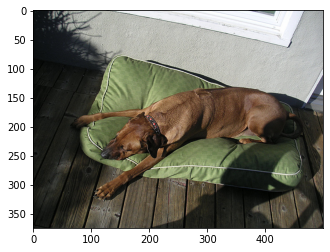

Real Caption: brown dog laying on green cushion
Predicted Caption: brown dog is laying on his back on the front of purple blanket
BLEU-1 score: 30.769230769230766
BLEU-2 score: 22.64554068289192
BLEU-3 score: 2.0758355536666792e-91
BLEU-4 score: 7.098450576376767e-153


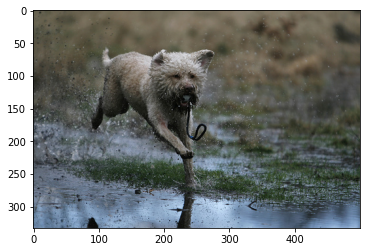

Real Caption: medium sized dog running through puddles
Predicted Caption: dog is shaking water off
BLEU-1 score: 16.374615061559638
BLEU-2 score: 5.461705981224581e-153
BLEU-3 score: 1.2937690606722724e-183
BLEU-4 score: 9.97486269044271e-230


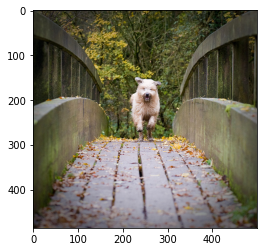

Real Caption: fluffy dog runs across bridge near forest
Predicted Caption: white dog is running down bridge
BLEU-1 score: 28.2160574963538
BLEU-2 score: 7.290027635886345e-153
BLEU-3 score: 1.5591498913318324e-183
BLEU-4 score: 1.171778691554733e-229


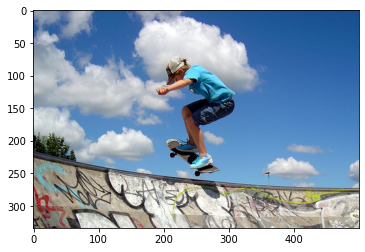

Real Caption: young man wearing blue shirt skateboarding on graffitied wall
Predicted Caption: boy in blue shirt is on skateboard above the concrete
BLEU-1 score: 30.0
BLEU-2 score: 18.257418583505533
BLEU-3 score: 1.8241769048702254e-91
BLEU-4 score: 6.373704167435468e-153


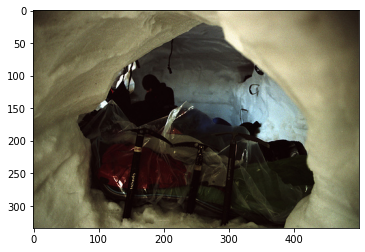

Real Caption: some backpacks piled up in an ice cave with person dressed in black in the background
Predicted Caption: person wearing blue hat and jacket is moving through white tent
BLEU-1 score: 5.770331081275289
BLEU-2 score: 2.854757945924487e-153
BLEU-3 score: 7.917394236512313e-184
BLEU-4 score: 6.3497053018839555e-230


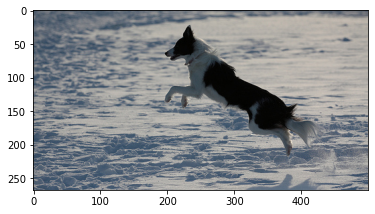

Real Caption: black and white dog jumping in the snow
Predicted Caption: dog jumps in the snow
BLEU-1 score: 43.90493088752211
BLEU-2 score: 34.70989552921196
BLEU-3 score: 29.985060665861457
BLEU-4 score: 4.050364452470092e-76


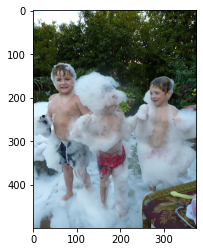

Real Caption: three children covered in soap bubbles smile
Predicted Caption: three children in bathing suits are playing in foam
BLEU-1 score: 33.33333333333333
BLEU-2 score: 20.412414523193153
BLEU-3 score: 1.9504730631920925e-91
BLEU-4 score: 6.7393716283177e-153


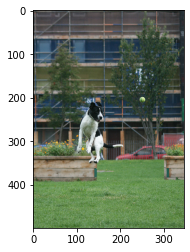

Real Caption: black and white dog jumping for ball
Predicted Caption: dog jumps to get the frisbee
BLEU-1 score: 14.108028748176901
BLEU-2 score: 5.154827976372712e-153
BLEU-3 score: 1.2664232355128374e-183
BLEU-4 score: 9.853445011990207e-230


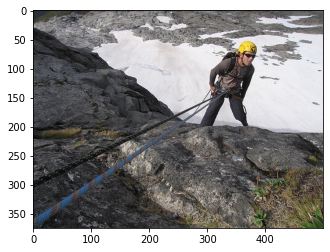

Real Caption: man in yellow helmet climbs cliff face snow behind him
Predicted Caption: man in blue shirt and helmet stands inside rock
BLEU-1 score: 29.827977227145652
BLEU-2 score: 18.26583106646588
BLEU-3 score: 1.745359983331643e-91
BLEU-4 score: 6.030654703641958e-153


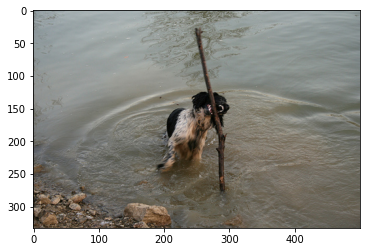

Real Caption: black and white dog outdoors in muddy water with stick in mouth
Predicted Caption: black and white dog with stick is in muddy water
BLEU-1 score: 73.68576777701837
BLEU-2 score: 63.418611433977624
BLEU-3 score: 52.33543750400307
BLEU-4 score: 34.666677727296225


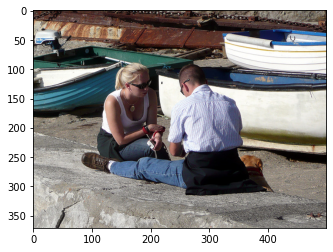

Real Caption: blonde woman in white tank top and sunglasses is talking to man sitting next to boats on rock surface
Predicted Caption: man and woman are sitting by boats
BLEU-1 score: 12.863736581996596
BLEU-2 score: 2.2704051945109873e-153
BLEU-3 score: 4.1693026527169313e-184
BLEU-4 score: 3.016278847620615e-230


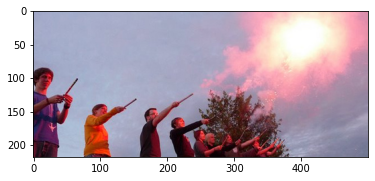

Real Caption: people in line holding lit roman candles
Predicted Caption: group of people are together in the snow
BLEU-1 score: 25.0
BLEU-2 score: 7.458340731200295e-153
BLEU-3 score: 1.6896185209462902e-183
BLEU-4 score: 1.2882297539194153e-229


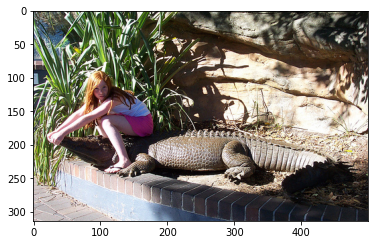

Real Caption: girl holding crocodile mouth closed
Predicted Caption: girl is sitting on round bench on the road
BLEU-1 score: 11.111111111111109
BLEU-2 score: 4.972227154133551e-153
BLEU-3 score: 1.3247499323693867e-183
BLEU-4 score: 1.0518351895246306e-229


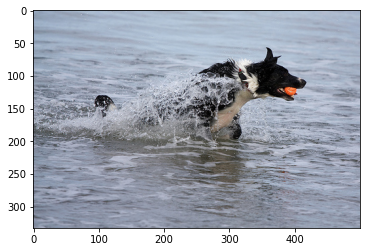

Real Caption: the black dog is running through the water with red ball in its mouth
Predicted Caption: the dog is running through the water with red object in its mouth
BLEU-1 score: 85.47333033621379
BLEU-2 score: 77.04461880297264
BLEU-3 score: 72.40925609995942
BLEU-4 score: 63.43608337535854


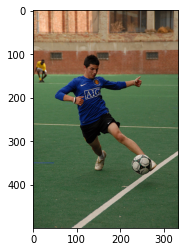

Real Caption: man kicks soccer ball on field
Predicted Caption: man in blue and white striped shirt is hitting soccer ball
BLEU-1 score: 27.27272727272727
BLEU-2 score: 16.514456476895408
BLEU-3 score: 1.7175994813661398e-91
BLEU-4 score: 6.061838450024688e-153


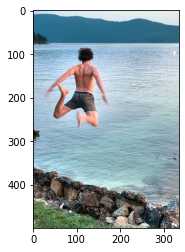

Real Caption: man jumping near rocks and body of water
Predicted Caption: man jumping into the water
BLEU-1 score: 32.928698165641585
BLEU-2 score: 21.255383267970096
BLEU-3 score: 1.572005343699657e-91
BLEU-4 score: 5.094696780347207e-153


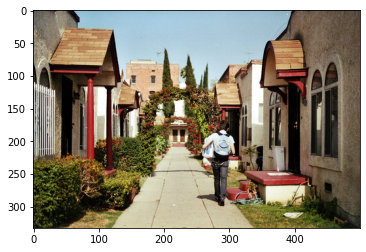

Real Caption: person with backpack carrying bags of groceries down sidewalk between houses
Predicted Caption: woman in blue coat and brown striped shirt is on the sidewalk of colorful sidewalk
BLEU-1 score: 13.333333333333334
BLEU-2 score: 5.4468019467172e-153
BLEU-3 score: 1.3992273317570998e-183
BLEU-4 score: 1.1008876702055895e-229


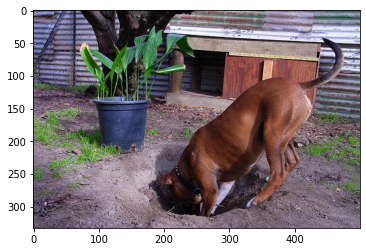

Real Caption: brown dog digging hole in front of plant
Predicted Caption: brown dog is digging hole in the yard and takes drink
BLEU-1 score: 45.45454545454545
BLEU-2 score: 36.92744729379982
BLEU-3 score: 28.453573624306514
BLEU-4 score: 4.284993070788676e-76


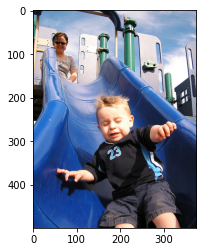

Real Caption: young boy slides down blue slide with his eyes closed while woman with sunglasses watches smiling
Predicted Caption: boy is riding on an amusement park ride
BLEU-1 score: 4.59849301464303
BLEU-2 score: 1.9401385287637276e-153
BLEU-3 score: 5.048765283268975e-184
BLEU-4 score: 3.985119463158008e-230


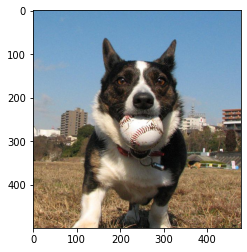

Real Caption: black and white dog holding baseball in mouth
Predicted Caption: black and white dog is playing with water baseball
BLEU-1 score: 55.55555555555556
BLEU-2 score: 45.64354645876384
BLEU-3 score: 42.89505366341148
BLEU-4 score: 31.55984539112945


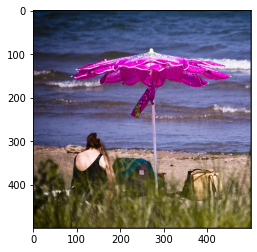

Real Caption: woman sitting on the beach under pink lawn umbrella
Predicted Caption: woman in black swimsuit is sitting under purple umbrella on the beach next to the ocean
BLEU-1 score: 43.75
BLEU-2 score: 24.152294576982403
BLEU-3 score: 19.316864235990856
BLEU-4 score: 3.103010873451748e-76


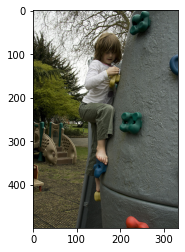

Real Caption: little girl climbs up rock climbing jungle gym at park
Predicted Caption: the little girl in the blue dress is climbing wall
BLEU-1 score: 30.0
BLEU-2 score: 18.257418583505533
BLEU-3 score: 1.8241769048702254e-91
BLEU-4 score: 6.373704167435468e-153


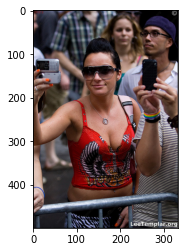

Real Caption: woman in red shirt holding cellphone
Predicted Caption: woman in black shirt is holding small girl in hot orange and white dress
BLEU-1 score: 28.57142857142857
BLEU-2 score: 14.824986333222023
BLEU-3 score: 1.6099037441710956e-91
BLEU-4 score: 5.74340400309589e-153


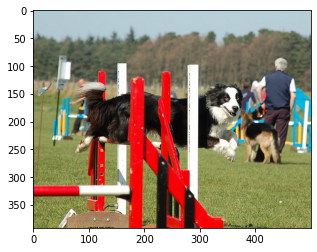

Real Caption: dog jumps over red and white gate
Predicted Caption: the dog jumps over an obstacle
BLEU-1 score: 42.324086244530704
BLEU-2 score: 37.855813571333776
BLEU-3 score: 34.45946953219957
BLEU-4 score: 4.888731610154635e-76


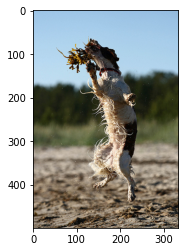

Real Caption: white and brown dog is playing in the dirt with toy
Predicted Caption: dog is running along the beach
BLEU-1 score: 21.729910425353914
BLEU-2 score: 13.743202059111331
BLEU-3 score: 1.1022783086561772e-91
BLEU-4 score: 3.645525559050358e-153


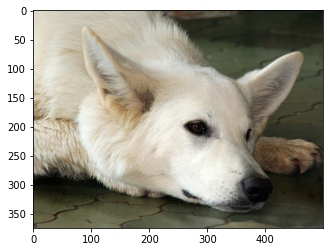

Real Caption: closeup of white dog that is laying its head on its paws
Predicted Caption: white dog is resting its head its head on tiled floor with its eyes open
BLEU-1 score: 46.666666666666664
BLEU-2 score: 31.62277660168379
BLEU-3 score: 23.217582333658846
BLEU-4 score: 3.617014666551307e-76


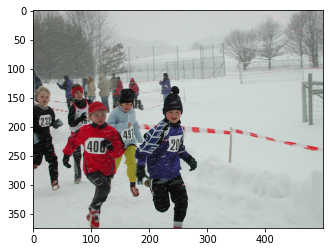

Real Caption: the children are running in the snow with fences in the background
Predicted Caption: group of children run in the snow
BLEU-1 score: 27.973809117540178
BLEU-2 score: 21.365349626228948
BLEU-3 score: 18.36753446625655
BLEU-4 score: 2.6414563398055774e-76


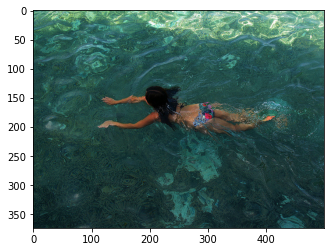

Real Caption: girl in bikini swimming in body of water
Predicted Caption: the little girl in pink swimsuit is swimming in the water
BLEU-1 score: 45.45454545454545
BLEU-2 score: 30.15113445777636
BLEU-3 score: 2.4648217855445784e-91
BLEU-4 score: 8.190757052088229e-153


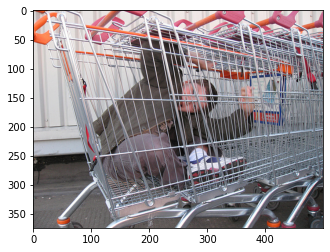

Real Caption: child plays inside shopping cart that has been <unk> with others to <unk> cage
Predicted Caption: young boy wearing paper boots is sitting inside shopping cart
BLEU-1 score: 20.10960138106918
BLEU-2 score: 17.307589166166796
BLEU-3 score: 15.94145044326182
BLEU-4 score: 2.473563156900434e-76


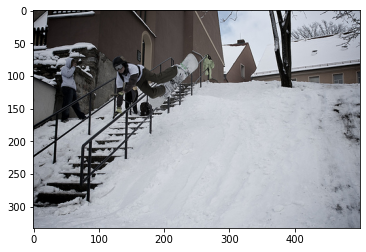

Real Caption: person snowboarding on hill near snow covered stairs with buildings nearby
Predicted Caption: snowboarder goes down short hill next to stairs
BLEU-1 score: 17.182231969774307
BLEU-2 score: 5.126037622123983e-153
BLEU-3 score: 1.1612566946930451e-183
BLEU-4 score: 8.853864984883468e-230


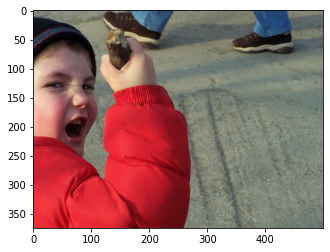

Real Caption: young boy wearing red winter coat is eating and holding up candy bar
Predicted Caption: child in red jacket with plastic object and yelling
BLEU-1 score: 14.248453076221212
BLEU-2 score: 4.5086465338368087e-153
BLEU-3 score: 1.0457385906395474e-183
BLEU-4 score: 8.020204191025903e-230


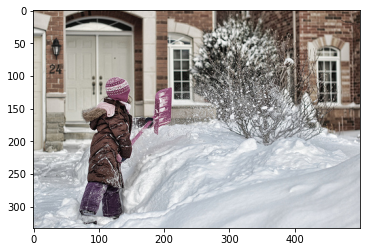

Real Caption: the child is shoveling deep white snow near the house
Predicted Caption: the girl is through the snow
BLEU-1 score: 34.227807935506135
BLEU-2 score: 6.253122426428973e-153
BLEU-3 score: 1.1642590608814067e-183
BLEU-4 score: 8.451929273732148e-230


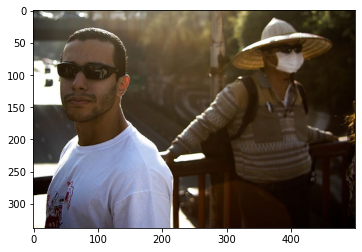

Real Caption: the man is wearing white shirt and sunglasses
Predicted Caption: man in black shirt is holding camera
BLEU-1 score: 37.1519099892935
BLEU-2 score: 8.465288316962106e-153
BLEU-3 score: 1.7217557990773525e-183
BLEU-4 score: 1.2778269941762074e-229


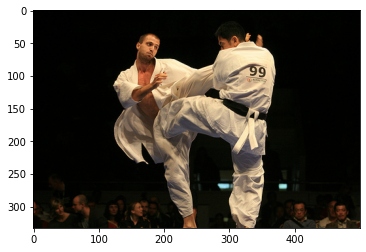

Real Caption: two men are participating in karate match
Predicted Caption: two men are wrestling in match
BLEU-1 score: 70.5401437408845
BLEU-2 score: 48.87164517296948
BLEU-3 score: 40.16642808229264
BLEU-4 score: 5.554671532919683e-76


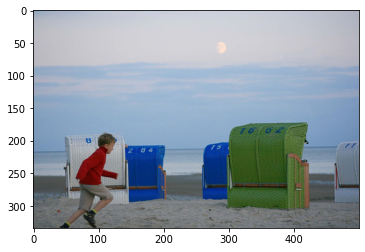

Real Caption: boy in red sweater running on the beach
Predicted Caption: young boy wearing red runs on beach with green white and blue structures and half moon behind him
BLEU-1 score: 22.22222222222222
BLEU-2 score: 7.031791076575252e-153
BLEU-3 score: 1.6309584783156365e-183
BLEU-4 score: 1.2508498911928378e-229


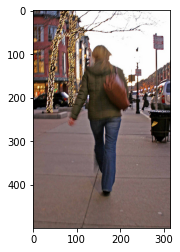

Real Caption: lady in winter wear carrying purse walks down the sidewalk
Predicted Caption: woman in black shirt and white hat rollerblading down the street
BLEU-1 score: 27.27272727272727
BLEU-2 score: 16.514456476895408
BLEU-3 score: 1.7175994813661398e-91
BLEU-4 score: 6.061838450024688e-153


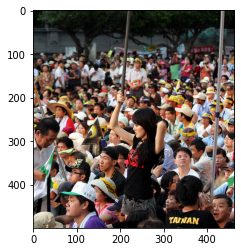

Real Caption: young woman standing above crowd
Predicted Caption: people are watching guy in black and white baseball cap
BLEU-1 score: 0
BLEU-2 score: 0
BLEU-3 score: 0
BLEU-4 score: 0


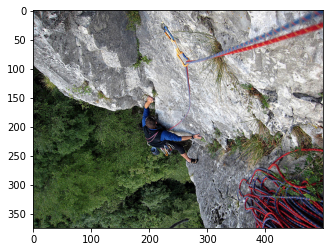

Real Caption: man in blue shirt is rock climbing
Predicted Caption: person wearing blue hat climbs down very tall cliff
BLEU-1 score: 11.111111111111109
BLEU-2 score: 4.972227154133551e-153
BLEU-3 score: 1.3247499323693867e-183
BLEU-4 score: 1.0518351895246306e-229


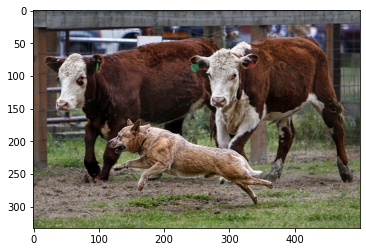

Real Caption: dog runs by two cows
Predicted Caption: dog chases deer
BLEU-1 score: 17.113903967753068
BLEU-2 score: 4.421625271317475e-153
BLEU-3 score: 9.45672212180377e-184
BLEU-4 score: 7.107197028258988e-230


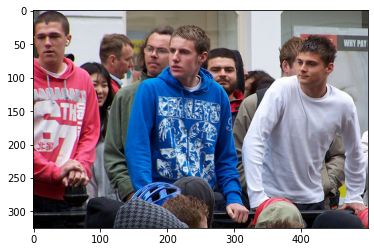

Real Caption: group of several people standing around railing
Predicted Caption: group of people are standing next to each other and taking an event
BLEU-1 score: 30.769230769230766
BLEU-2 score: 16.012815380508712
BLEU-3 score: 1.6861024029072228e-91
BLEU-4 score: 5.969061643530969e-153


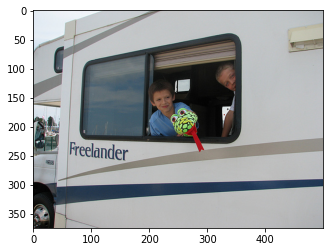

Real Caption: two children peek out the window of an rv with pet snake
Predicted Caption: two young women wearing dresses posing on the side of their road
BLEU-1 score: 25.0
BLEU-2 score: 7.458340731200295e-153
BLEU-3 score: 1.6896185209462902e-183
BLEU-4 score: 1.2882297539194153e-229


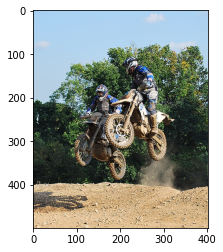

Real Caption: two motorcycles jump over dirt hill
Predicted Caption: person on bmx bike
BLEU-1 score: 0
BLEU-2 score: 0
BLEU-3 score: 0
BLEU-4 score: 0


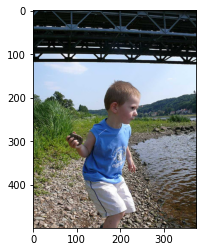

Real Caption: little boy is ready to throw stone into the water
Predicted Caption: boy plays in the water
BLEU-1 score: 22.07276647028654
BLEU-2 score: 14.247909490690875
BLEU-3 score: 1.0537466943570253e-91
BLEU-4 score: 3.4150773803399635e-153


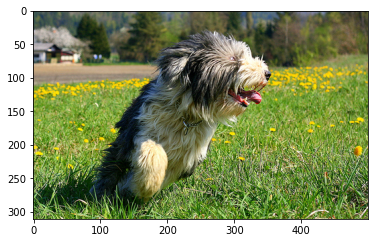

Real Caption: dog sitting in the grass with his tongue out
Predicted Caption: dog in field of long grass and yellow flowers
BLEU-1 score: 33.33333333333333
BLEU-2 score: 8.612150057732662e-153
BLEU-3 score: 1.8419179593432007e-183
BLEU-4 score: 1.384292958842266e-229


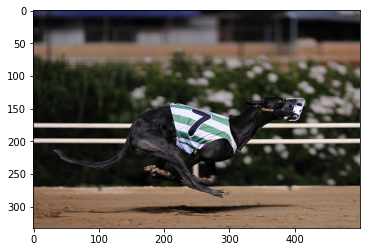

Real Caption: black greyhound with the number seven is in the middle of race
Predicted Caption: black greyhound dog racing down track
BLEU-1 score: 12.262648039048077
BLEU-2 score: 9.49860632712725
BLEU-3 score: 8.261929215253368e-92
BLEU-4 score: 2.788399004651202e-153


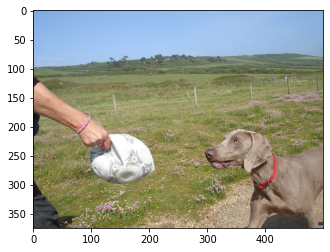

Real Caption: large gray dog being handed white soccer ball
Predicted Caption: the brown dog is playing with frisbee
BLEU-1 score: 12.383969996431167
BLEU-2 score: 4.887436488566011e-153
BLEU-3 score: 1.2383265317623888e-183
BLEU-4 score: 9.709385502639236e-230


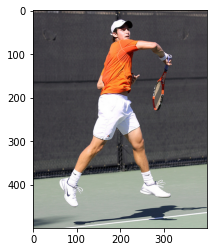

Real Caption: the tennis player holds his racket in <unk> for the ball
Predicted Caption: man in an orange shirt and white shorts playing tennis
BLEU-1 score: 18.096748360719193
BLEU-2 score: 6.036118613529225e-153
BLEU-3 score: 1.4298359405610435e-183
BLEU-4 score: 1.1023928157275092e-229


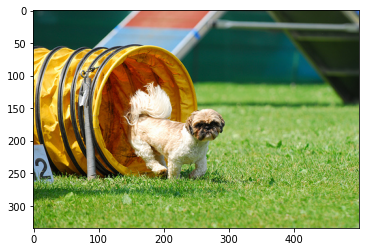

Real Caption: little brown and white dog emerges from yellow <unk> toy tunnel onto the lawn
Predicted Caption: the dog is jumping over low yellow and white fence
BLEU-1 score: 33.51600230178197
BLEU-2 score: 15.799595003902642
BLEU-3 score: 1.4252917953117217e-91
BLEU-4 score: 4.854408244229234e-153


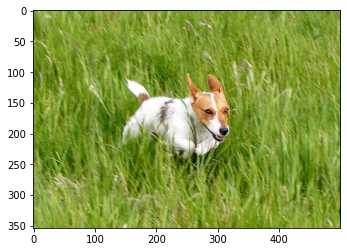

Real Caption: medium sized brown and white streaked dog is running through tall grass
Predicted Caption: dog is running through field of tall grass and tall grass
BLEU-1 score: 58.10640921796215
BLEU-2 score: 46.068211980718985
BLEU-3 score: 38.57309911372216
BLEU-4 score: 26.477952261405967


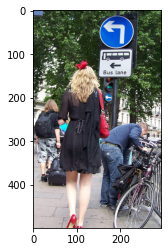

Real Caption: man chains his bike to rack while woman in black and red walks
Predicted Caption: man in black tank top holding bike helmet of football
BLEU-1 score: 29.632728827268718
BLEU-2 score: 15.617819396716564
BLEU-3 score: 1.4731949770081463e-91
BLEU-4 score: 5.07385721693611e-153


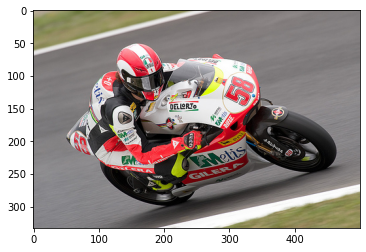

Real Caption: red and white motorcycle is being ridden around bend on racetrack
Predicted Caption: motorcycle racer leaning over to take sharp turn
BLEU-1 score: 8.591115984887153
BLEU-2 score: 3.6246559632213337e-153
BLEU-3 score: 9.432335330491414e-184
BLEU-4 score: 7.445183326929417e-230


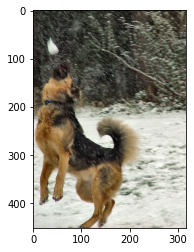

Real Caption: dog tries to catch snowball in its mouth
Predicted Caption: dog jumps to catch snowball
BLEU-1 score: 43.90493088752211
BLEU-2 score: 34.70989552921196
BLEU-3 score: 29.985060665861457
BLEU-4 score: 4.050364452470092e-76


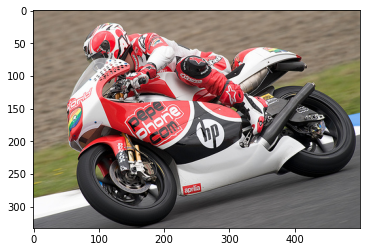

Real Caption: motorcycle racer in soft turn on an <unk> <unk> motorcycle
Predicted Caption: motorcycle racer leaning into curve with another racer
BLEU-1 score: 19.470019576785123
BLEU-2 score: 14.717951377637847
BLEU-3 score: 1.4503816601791856e-91
BLEU-4 score: 5.050205928624139e-153


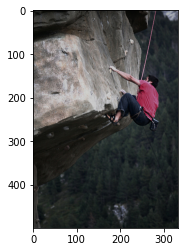

Real Caption: man in pink shirt climbs rock face
Predicted Caption: rock climber practices on rock climbing wall
BLEU-1 score: 14.285714285714285
BLEU-2 score: 5.637975647982814e-153
BLEU-3 score: 1.4284901392909564e-183
BLEU-4 score: 1.1200407237786664e-229


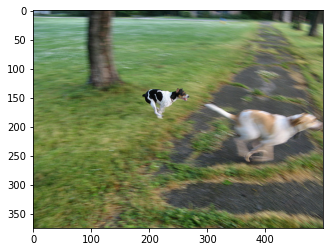

Real Caption: two dogs are running across grassy path
Predicted Caption: white dog with brown ears runs on the grass with its mouth open
BLEU-1 score: 0
BLEU-2 score: 0
BLEU-3 score: 0
BLEU-4 score: 0


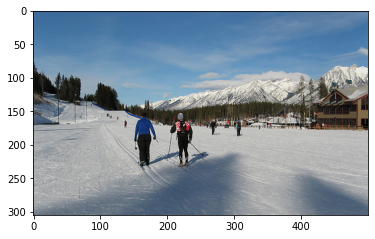

Real Caption: skiiers are walking through the snow near the mountains
Predicted Caption: two people wearing skis on concrete surface with mountains in the background
BLEU-1 score: 16.666666666666668
BLEU-2 score: 6.08970970641905e-153
BLEU-3 score: 1.4961022763680928e-183
BLEU-4 score: 1.1640469867513693e-229


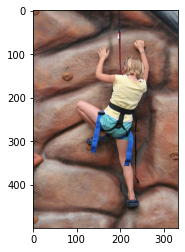

Real Caption: woman in blue shorts and white shirt is indoor rock climbing
Predicted Caption: woman climbs steep rock face
BLEU-1 score: 12.04776847648808
BLEU-2 score: 2.8415076727790637e-153
BLEU-3 score: 5.859644627459847e-184
BLEU-4 score: 4.3638512969692e-230


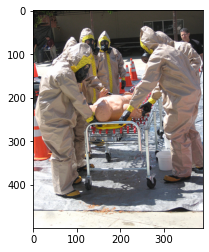

Real Caption: people wearing suits practicing rescue in dangerous environment
Predicted Caption: group of people are looking at an airport
BLEU-1 score: 12.500000000000004
BLEU-2 score: 5.273843307431706e-153
BLEU-3 score: 1.372396692566494e-183
BLEU-4 score: 1.0832677820940878e-229


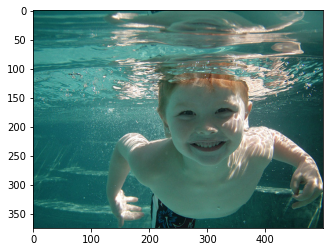

Real Caption: the boys smiles underwater at the pool
Predicted Caption: small boy wearing black and white shirt is being held by the hands over the water
BLEU-1 score: 12.500000000000004
BLEU-2 score: 5.273843307431706e-153
BLEU-3 score: 1.372396692566494e-183
BLEU-4 score: 1.0832677820940878e-229


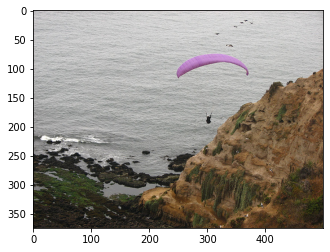

Real Caption: paraglider soars near cliff and over body of water
Predicted Caption: scenic view with person dangling precariously from the top of cliff
BLEU-1 score: 18.181818181818183
BLEU-2 score: 6.360494346864464e-153
BLEU-3 score: 1.5356698295026469e-183
BLEU-4 score: 1.1896457329133972e-229


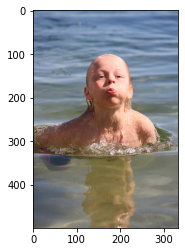

Real Caption: the small child comes up from underwater
Predicted Caption: blonde child swims
BLEU-1 score: 8.786571270524224
BLEU-2 score: 2.2701381082415207e-153
BLEU-3 score: 4.855243027268271e-184
BLEU-4 score: 3.648956622645728e-230


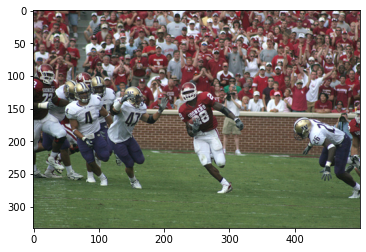

Real Caption: the american football team in white are attempting to stop the player in red who is running with the ball
Predicted Caption: football player in sooners jersey runs with the ball chased by members of the opposing team
BLEU-1 score: 38.94003915357025
BLEU-2 score: 24.627843180283442
BLEU-3 score: 17.68430387104995
BLEU-4 score: 2.7652250244217536e-76


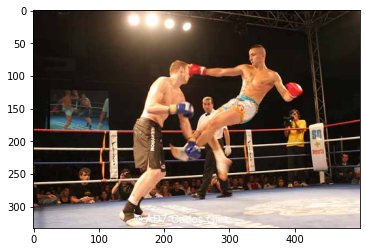

Real Caption: <unk> jumping for kick
Predicted Caption: two boxers fight in ring surrounded by seating
BLEU-1 score: 0
BLEU-2 score: 0
BLEU-3 score: 0
BLEU-4 score: 0


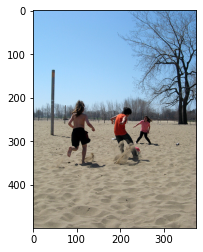

Real Caption: three people playing with red ball in large sandy area with tree in the background
Predicted Caption: three people are kicking ball in the sand
BLEU-1 score: 26.053876229906773
BLEU-2 score: 21.5746592083525
BLEU-3 score: 1.4209101853535793e-91
BLEU-4 score: 4.473426973085368e-153


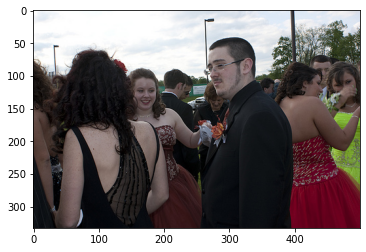

Real Caption: man in black suit looking at woman in black dress
Predicted Caption: an asian man in pink and an shirt is surrounded by women in black
BLEU-1 score: 28.57142857142857
BLEU-2 score: 20.965696734438367
BLEU-3 score: 1.9820240006592639e-91
BLEU-4 score: 6.830096904817037e-153


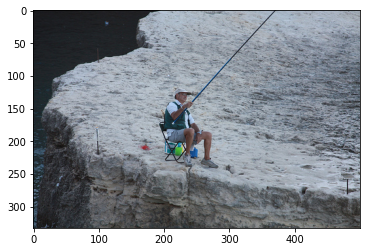

Real Caption: man sits in camping chair near the edge of rock face over body of water
Predicted Caption: man sits on chair near edge of cliff fishing
BLEU-1 score: 34.227807935506135
BLEU-2 score: 25.6708559516296
BLEU-3 score: 1.7141770543553292e-91
BLEU-4 score: 5.415362874261817e-153


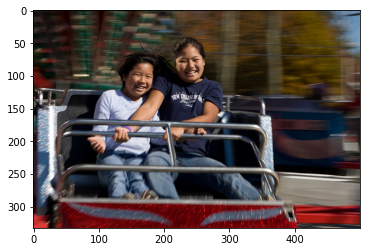

Real Caption: two girls on an amusement park ride
Predicted Caption: two people are sitting on fairground ride
BLEU-1 score: 42.857142857142854
BLEU-2 score: 9.765260274142007e-153
BLEU-3 score: 1.9861572195732883e-183
BLEU-4 score: 1.4740564900137074e-229


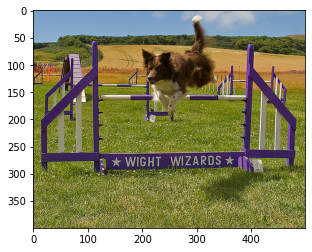

Real Caption: brown and white dog jumps over purple and white hurdle in field
Predicted Caption: the brown and white dog is leaping over red and white bar
BLEU-1 score: 58.333333333333336
BLEU-2 score: 46.05661864718383
BLEU-3 score: 38.75111728459438
BLEU-4 score: 26.202510071732622


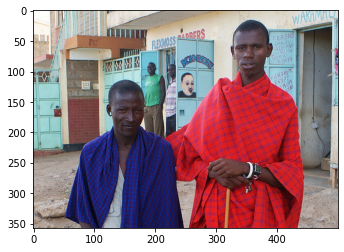

Real Caption: man wearing red cloth stands next to man wearing blue cloth
Predicted Caption: man in black and red is looking at the camera someone in red and jacket
BLEU-1 score: 13.333333333333334
BLEU-2 score: 5.4468019467172e-153
BLEU-3 score: 1.3992273317570998e-183
BLEU-4 score: 1.1008876702055895e-229


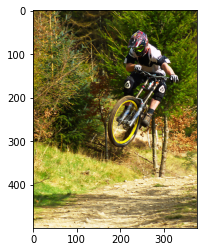

Real Caption: man performing trick on bicycle outside
Predicted Caption: bicyclist with green shirt rides through the woods
BLEU-1 score: 0
BLEU-2 score: 0
BLEU-3 score: 0
BLEU-4 score: 0


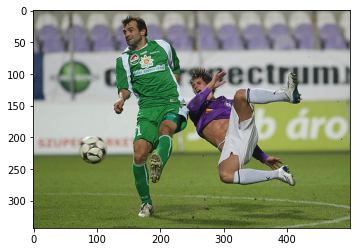

Real Caption: two men wearing different colored uniforms playing soccer
Predicted Caption: two soccer players kick soccer ball
BLEU-1 score: 23.88437701912631
BLEU-2 score: 6.17087516772532e-153
BLEU-3 score: 1.319791889377583e-183
BLEU-4 score: 9.918892480173173e-230


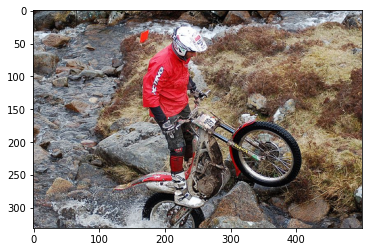

Real Caption: bmx biker in shallow stream with current performing wheelie
Predicted Caption: motocross bike is being ridden over rocks
BLEU-1 score: 0
BLEU-2 score: 0
BLEU-3 score: 0
BLEU-4 score: 0


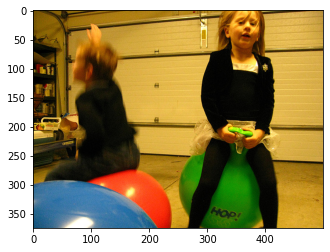

Real Caption: the children are wearing black tights while hopping
Predicted Caption: two kids are bouncing on colorful balls
BLEU-1 score: 12.383969996431167
BLEU-2 score: 4.887436488566011e-153
BLEU-3 score: 1.2383265317623888e-183
BLEU-4 score: 9.709385502639236e-230


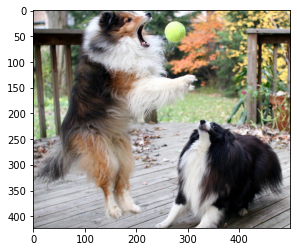

Real Caption: two dogs play with green ball on wooden deck
Predicted Caption: two dogs playing with tennis ball in house
BLEU-1 score: 44.124845129229776
BLEU-2 score: 23.585721816862673
BLEU-3 score: 2.0233830542837192e-91
BLEU-4 score: 6.805395922591311e-153


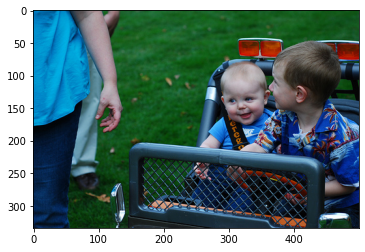

Real Caption: two little boys sit in toy car on the grass
Predicted Caption: two young children ride in toy truck
BLEU-1 score: 27.91881675133095
BLEU-2 score: 17.410441154600917
BLEU-3 score: 1.493615157227752e-91
BLEU-4 score: 5.023587836914362e-153


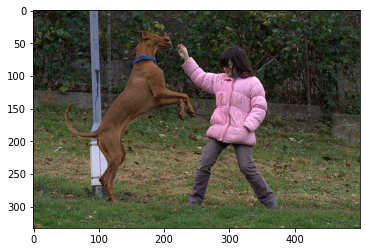

Real Caption: woman is standing in front of dog that standing on its hind legs
Predicted Caption: brown dog is jumping in the air to catch girl wearing pink collar
BLEU-1 score: 23.076923076923077
BLEU-2 score: 7.165741990418252e-153
BLEU-3 score: 1.6495292825393885e-183
BLEU-4 score: 1.2627076138080563e-229


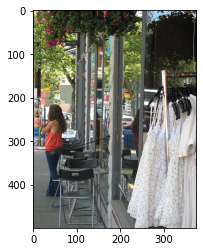

Real Caption: woman stands near chairs and tables outside store
Predicted Caption: man is helping girl in front of
BLEU-1 score: 0
BLEU-2 score: 0
BLEU-3 score: 0
BLEU-4 score: 0


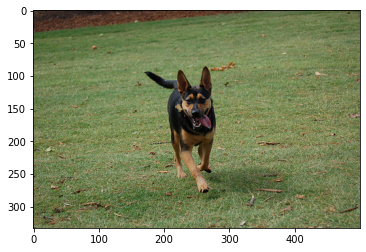

Real Caption: black and brown dog running across the grass
Predicted Caption: black and brown dog runs through field
BLEU-1 score: 49.53587998572467
BLEU-2 score: 46.33657281473354
BLEU-3 score: 45.22259869488732
BLEU-4 score: 35.64026463354183


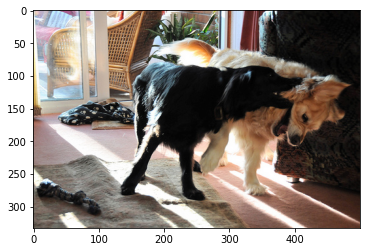

Real Caption: the black dog playfully bites the yellow dog near the furniture
Predicted Caption: black dog pulls on red object while another dog stands behind it
BLEU-1 score: 25.0
BLEU-2 score: 15.075567228888179
BLEU-3 score: 1.6261759223357467e-91
BLEU-4 score: 5.791739854583281e-153


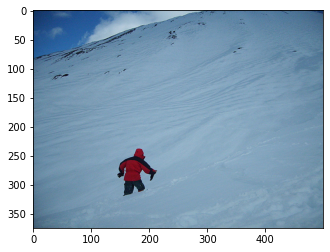

Real Caption: mountain climber climbing snowy mountaintop
Predicted Caption: man skis downhill on mountain
BLEU-1 score: 20.0
BLEU-2 score: 6.6709427497276e-153
BLEU-3 score: 1.5802130991274055e-183
BLEU-4 score: 1.2183324802375697e-229


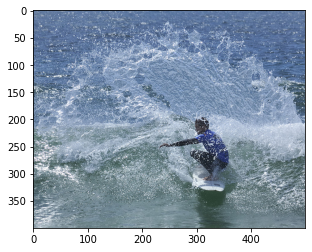

Real Caption: surfer is being splashed by an ocean wave
Predicted Caption: man in blue kayak
BLEU-1 score: 0
BLEU-2 score: 0
BLEU-3 score: 0
BLEU-4 score: 0


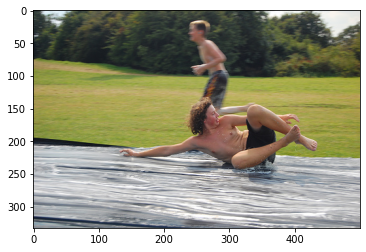

Real Caption: boy sliding on wet plastic surface
Predicted Caption: boy in black shorts and brown trunks is on trampoline
BLEU-1 score: 20.0
BLEU-2 score: 6.6709427497276e-153
BLEU-3 score: 1.5802130991274055e-183
BLEU-4 score: 1.2183324802375697e-229


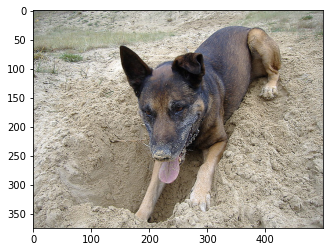

Real Caption: dog is digging hole in the sand
Predicted Caption: dog digging in the sand
BLEU-1 score: 67.03200460356393
BLEU-2 score: 47.398785011707936
BLEU-3 score: 39.15947242270031
BLEU-4 score: 5.230949200823748e-76


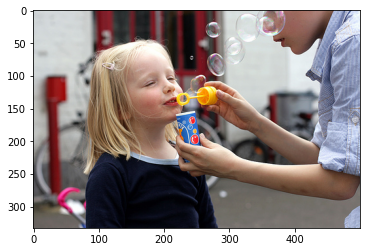

Real Caption: little girl with blonde hair and blue shirt is blowing bubbles outside with someone
Predicted Caption: girl is blowing bubbles through yellow sweater
BLEU-1 score: 21.021682352653848
BLEU-2 score: 16.0555751027256
BLEU-3 score: 13.802785081169489
BLEU-4 score: 1.984994460013648e-76


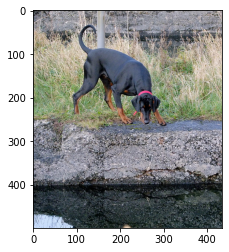

Real Caption: black dog with red collar sniffs the ground
Predicted Caption: black dog sniffing the ground near body of water
BLEU-1 score: 44.44444444444444
BLEU-2 score: 33.333333333333336
BLEU-3 score: 2.617764516460675e-91
BLEU-4 score: 8.612150057732662e-153


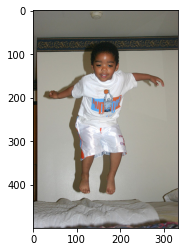

Real Caption: child in white jumping on bed
Predicted Caption: little boy is throwing into the air
BLEU-1 score: 0
BLEU-2 score: 0
BLEU-3 score: 0
BLEU-4 score: 0


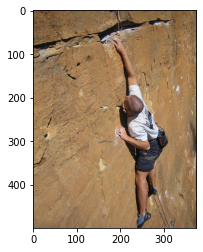

Real Caption: man rock climbing
Predicted Caption: man in white shirt and blue shorts on rock face
BLEU-1 score: 20.0
BLEU-2 score: 6.6709427497276e-153
BLEU-3 score: 1.5802130991274055e-183
BLEU-4 score: 1.2183324802375697e-229


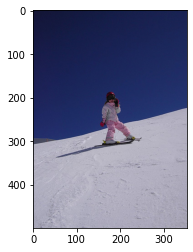

Real Caption: little girl skis on slope
Predicted Caption: snowboarder in yellow jacket is airborne on mountain
BLEU-1 score: 12.500000000000004
BLEU-2 score: 5.273843307431706e-153
BLEU-3 score: 1.372396692566494e-183
BLEU-4 score: 1.0832677820940878e-229


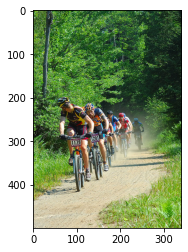

Real Caption: group of bikers riding through the woods
Predicted Caption: group of people are riding bicycles in race
BLEU-1 score: 37.5
BLEU-2 score: 23.145502494313785
BLEU-3 score: 2.1032131949153637e-91
BLEU-4 score: 7.176381577237209e-153


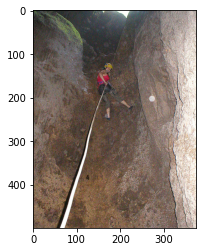

Real Caption: person is climbing rock while holding onto white rope
Predicted Caption: person in red shirt rock climbing
BLEU-1 score: 30.326532985631673
BLEU-2 score: 6.397495320955232e-153
BLEU-3 score: 1.261683487508958e-183
BLEU-4 score: 9.291879812217675e-230


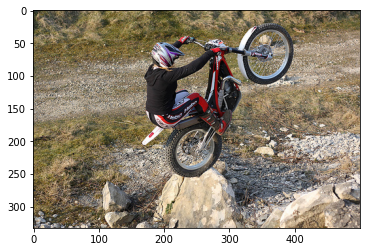

Real Caption: person rides their bicycle onto rock and balances on one wheel
Predicted Caption: person on motorcycle in the middle of jump above hill
BLEU-1 score: 18.096748360719193
BLEU-2 score: 6.036118613529225e-153
BLEU-3 score: 1.4298359405610435e-183
BLEU-4 score: 1.1023928157275092e-229


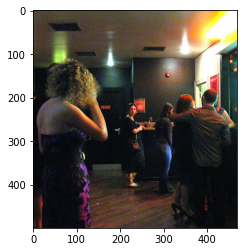

Real Caption: woman at bar looks on at another woman being approached by man
Predicted Caption: this woman is standing in front of people
BLEU-1 score: 7.581633246407919
BLEU-2 score: 3.1987476604776096e-153
BLEU-3 score: 8.324006713297918e-184
BLEU-4 score: 6.570351225189682e-230


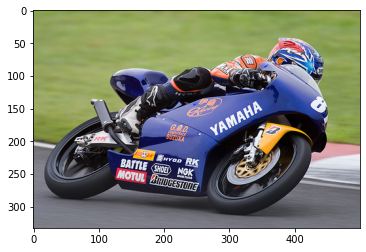

Real Caption: motorcyclist takes corner
Predicted Caption: motorcycle races
BLEU-1 score: 0
BLEU-2 score: 0
BLEU-3 score: 0
BLEU-4 score: 0


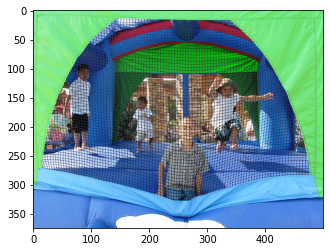

Real Caption: children play in the blue and green jumping tent filled with air
Predicted Caption: the children are playing in the indoor inflatable tunnel
BLEU-1 score: 23.88437701912631
BLEU-2 score: 14.62613413027904
BLEU-3 score: 1.3975750202079033e-91
BLEU-4 score: 4.828970785282295e-153


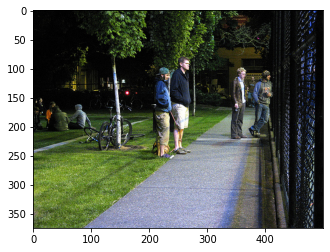

Real Caption: four people are looking through fence
Predicted Caption: group of people standing outside on the side of steps
BLEU-1 score: 10.000000000000002
BLEU-2 score: 4.717068855239749e-153
BLEU-3 score: 1.2835318765197404e-183
BLEU-4 score: 1.0244914152188952e-229


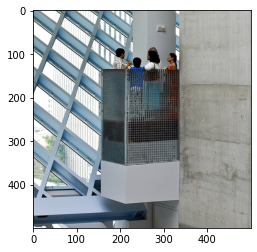

Real Caption: group of people stand on balcony
Predicted Caption: man in red shirt is standing outside of store
BLEU-1 score: 11.111111111111109
BLEU-2 score: 4.972227154133551e-153
BLEU-3 score: 1.3247499323693867e-183
BLEU-4 score: 1.0518351895246306e-229


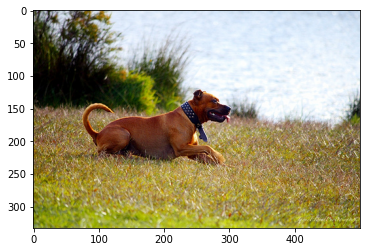

Real Caption: brown dog on the grass next to pond
Predicted Caption: brown dog wearing blue collar is running on the grass
BLEU-1 score: 50.0
BLEU-2 score: 40.8248290463863
BLEU-3 score: 31.306003451477082
BLEU-4 score: 4.640083527732319e-76


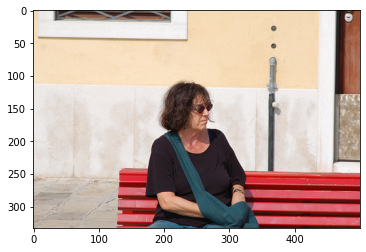

Real Caption: woman in black shirt sitting on red bench
Predicted Caption: man in black shirt is sitting on red bench with an open field
BLEU-1 score: 53.84615384615385
BLEU-2 score: 47.36654667156709
BLEU-3 score: 43.251542912584036
BLEU-4 score: 27.968424579665367


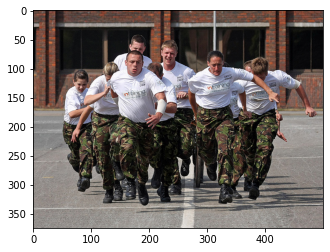

Real Caption: group of people wearing army clothes run together down the street
Predicted Caption: group of people in army pants running
BLEU-1 score: 32.26960697187196
BLEU-2 score: 24.646319432512993
BLEU-3 score: 21.188144802802952
BLEU-4 score: 3.0470915691434714e-76


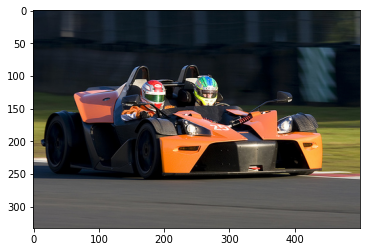

Real Caption: two racers driving an orange car
Predicted Caption: two people in an orange race car
BLEU-1 score: 57.14285714285714
BLEU-2 score: 30.860669992418384
BLEU-3 score: 2.499462007255115e-91
BLEU-4 score: 8.286571670851009e-153


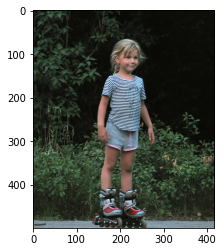

Real Caption: young girl on rollerblades
Predicted Caption: young girl has on rollerblades and looks ready to give it try
BLEU-1 score: 33.33333333333333
BLEU-2 score: 24.618298195866544
BLEU-3 score: 2.1825195678664249e-91
BLEU-4 score: 7.401184483348608e-153


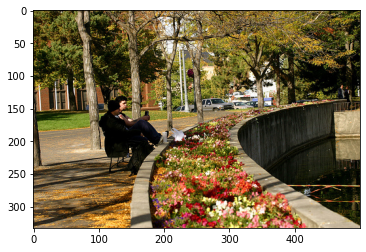

Real Caption: woman is sitting near flower bed overlooking tunnel
Predicted Caption: two people sit on bench at park
BLEU-1 score: 0
BLEU-2 score: 0
BLEU-3 score: 0
BLEU-4 score: 0


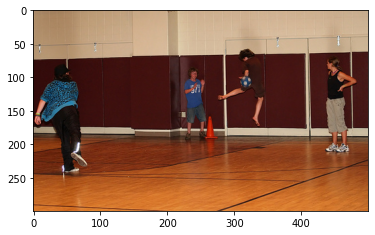

Real Caption: four people playing ball on court
Predicted Caption: two people are kicking soccer ball in basketball court
BLEU-1 score: 33.33333333333333
BLEU-2 score: 8.612150057732662e-153
BLEU-3 score: 1.8419179593432007e-183
BLEU-4 score: 1.384292958842266e-229


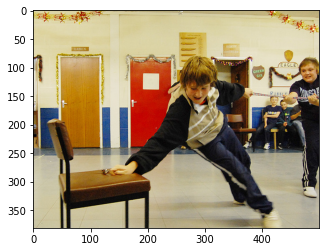

Real Caption: boy is leaning on chair whilst another boy pulls him around with rope
Predicted Caption: two boys hold up another girl and holds on to one arm while they do face
BLEU-1 score: 12.500000000000004
BLEU-2 score: 5.273843307431706e-153
BLEU-3 score: 1.372396692566494e-183
BLEU-4 score: 1.0832677820940878e-229


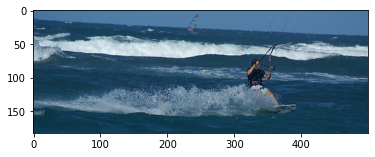

Real Caption: windsurfer on the water
Predicted Caption: man waterskis while being pulled
BLEU-1 score: 0
BLEU-2 score: 0
BLEU-3 score: 0
BLEU-4 score: 0


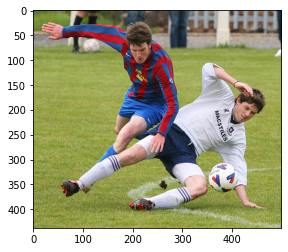

Real Caption: two men fall as they battle for soccer ball
Predicted Caption: two soccer players are going after the ball
BLEU-1 score: 33.09363384692233
BLEU-2 score: 8.061224930331203e-153
BLEU-3 score: 1.683950142240867e-183
BLEU-4 score: 1.258141043412406e-229


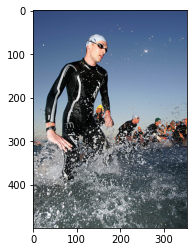

Real Caption: wave crashing through group of people wearing wetsuits and goggles
Predicted Caption: two surfers in the blue swim in the ocean
BLEU-1 score: 0
BLEU-2 score: 0
BLEU-3 score: 0
BLEU-4 score: 0


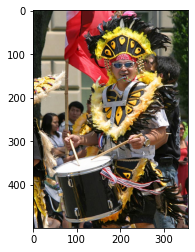

Real Caption: man in costume drums in parade
Predicted Caption: man wearing an indian costume is playing drum
BLEU-1 score: 25.0
BLEU-2 score: 7.458340731200295e-153
BLEU-3 score: 1.6896185209462902e-183
BLEU-4 score: 1.2882297539194153e-229


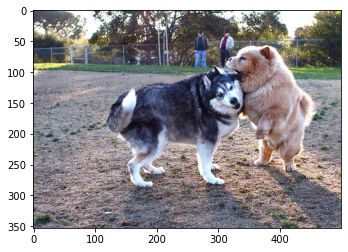

Real Caption: two dogs play in large area while two men watch from distance
Predicted Caption: two dogs are playing together outside with snow
BLEU-1 score: 15.163266492815836
BLEU-2 score: 11.462352058111218
BLEU-3 score: 1.1295583726999537e-91
BLEU-4 score: 3.9331043318843304e-153


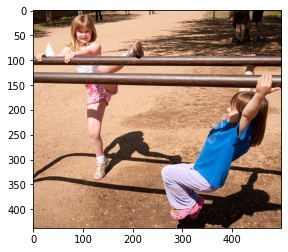

Real Caption: two girls playing on parallel bars at the playground
Predicted Caption: two girls play on set of parallel bars in playground
BLEU-1 score: 60.0
BLEU-2 score: 36.514837167011066
BLEU-3 score: 2.764935154957498e-91
BLEU-4 score: 9.013778876140909e-153


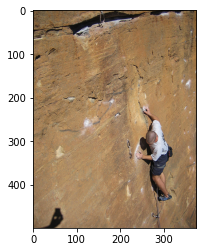

Real Caption: man climbs steep rock wall using safety ropes
Predicted Caption: man in white shirt and blue shorts on rock climbing rock
BLEU-1 score: 18.181818181818183
BLEU-2 score: 6.360494346864464e-153
BLEU-3 score: 1.5356698295026469e-183
BLEU-4 score: 1.1896457329133972e-229


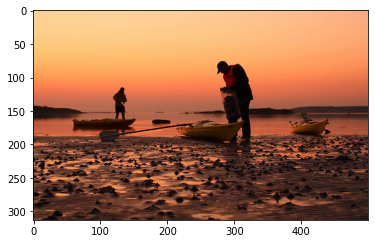

Real Caption: people possibly fishermen with their boats in shadow on shore at an <unk>
Predicted Caption: man and woman are standing next to an orange pole
BLEU-1 score: 7.40818220681718
BLEU-2 score: 3.4944905561718586e-153
BLEU-3 score: 9.508638009516205e-184
BLEU-4 score: 7.58961907326157e-230


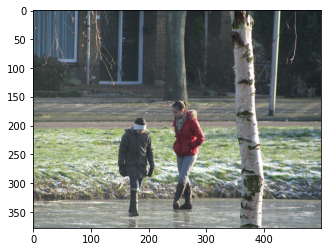

Real Caption: two people are walking through some water
Predicted Caption: two people dressed in winter apparel out onto frozen body of water
BLEU-1 score: 25.0
BLEU-2 score: 15.075567228888179
BLEU-3 score: 1.6261759223357467e-91
BLEU-4 score: 5.791739854583281e-153


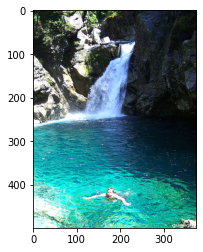

Real Caption: person swims in pool by waterfall
Predicted Caption: wet man floats on the edge of lake at duck
BLEU-1 score: 0
BLEU-2 score: 0
BLEU-3 score: 0
BLEU-4 score: 0


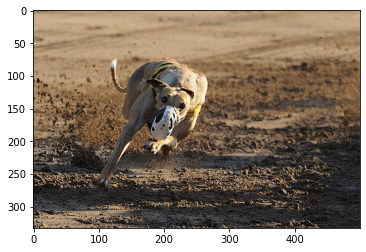

Real Caption: tan dog wearing muzzle is running on sand
Predicted Caption: large brown dog with muzzle is running on dirt path
BLEU-1 score: 50.0
BLEU-2 score: 40.8248290463863
BLEU-3 score: 38.54221125344267
BLEU-4 score: 27.776190340117914


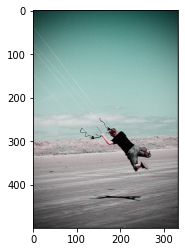

Real Caption: man eyes the ground as he comes in for landing from parasailing
Predicted Caption: man is doing flip off of water raft on cloudy day
BLEU-1 score: 8.300915602566022
BLEU-2 score: 4.1067149252095696e-153
BLEU-3 score: 1.1389575472159276e-183
BLEU-4 score: 9.1343749725459e-230


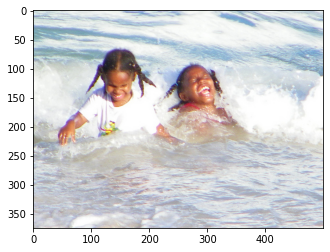

Real Caption: two small girls laugh as wave hits them at the beach
Predicted Caption: the two girls are in the water and one has white shirt on
BLEU-1 score: 23.076923076923077
BLEU-2 score: 7.165741990418252e-153
BLEU-3 score: 1.6495292825393885e-183
BLEU-4 score: 1.2627076138080563e-229


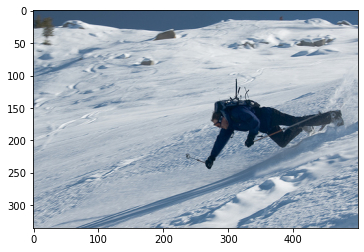

Real Caption: skier is falling face first into the snow
Predicted Caption: skier falls down hill
BLEU-1 score: 9.196986029286059
BLEU-2 score: 2.743770220260171e-153
BLEU-3 score: 6.215759172786402e-184
BLEU-4 score: 4.739132419722992e-230


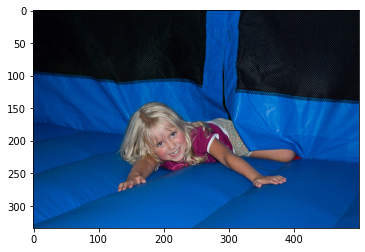

Real Caption: young girl laying on blue inflatable toy
Predicted Caption: little blonde girl crawling into blue inflatable bouncy house
BLEU-1 score: 33.33333333333333
BLEU-2 score: 20.412414523193153
BLEU-3 score: 1.9504730631920925e-91
BLEU-4 score: 6.7393716283177e-153


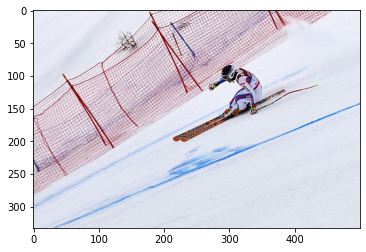

Real Caption: guy snowboarding down hill
Predicted Caption: skier in ski suit is skiing downhill near fence
BLEU-1 score: 0
BLEU-2 score: 0
BLEU-3 score: 0
BLEU-4 score: 0


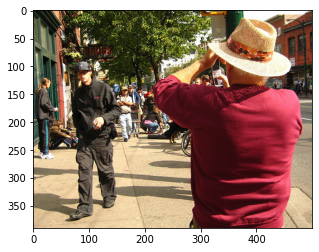

Real Caption: man with hat taking photo with his camera while passerby looks <unk>
Predicted Caption: the man in the black jacket is taking photograph of the man in the red jacket
BLEU-1 score: 12.500000000000004
BLEU-2 score: 5.273843307431706e-153
BLEU-3 score: 1.372396692566494e-183
BLEU-4 score: 1.0832677820940878e-229


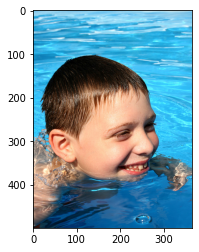

Real Caption: boy swims in the pool
Predicted Caption: smiling boy swims with only his head above the water
BLEU-1 score: 30.0
BLEU-2 score: 18.257418583505533
BLEU-3 score: 1.8241769048702254e-91
BLEU-4 score: 6.373704167435468e-153


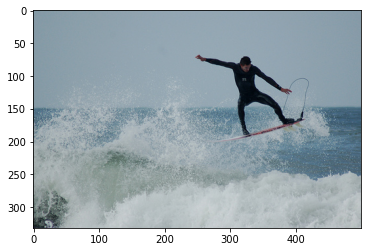

Real Caption: man rides wave on surfboard
Predicted Caption: man in black and blue is surfing on wave
BLEU-1 score: 33.33333333333333
BLEU-2 score: 8.612150057732662e-153
BLEU-3 score: 1.8419179593432007e-183
BLEU-4 score: 1.384292958842266e-229
BLEU-1 count: 200
BLEU-2 count: 100
BLEU-3 count: 40
BLEU-4 count: 12
BLEU-1 Total: 55.96474759527731
BLEU-2 Total: 25.404778298371284
BLEU-3 Total: 11.892729679329475
BLEU-4 Total: 3.582269909130656
BLEU-1 Average: 0.27982373797638654
BLEU-2 Average: 0.25404778298371283
BLEU-3 Average: 0.29731824198323686
BLEU-4 Average: 0.29852249242755463


'\nprint(f"BLEU-1 count: {blue_count_1}", f"BLEU-1 Average: {blue_1/blue_count_1}")\nprint(f"BLEU-1 count: {blue_count_2}",f"BLEU-1 Average: {blue_2/blue_count_2}")\nprint(f"BLEU-1 count: {blue_count_3}",f"BLEU-1 Average: {blue_3/blue_count_3}")\nprint(f"BLEU-1 count: {blue_count_4}",f"BLEU-1 Average: {blue_4/blue_count_4}")\n'

In [ ]:
blue_1 = 0
blue_2 = 0
blue_3 = 0
blue_4 = 0
blue_count_1 = 0
blue_count_2 = 0
blue_count_3 = 0
blue_count_4 = 0
for j in range(250):
    start_token = tokenizer.word_index['<start>']
    end_token = tokenizer.word_index['<end>']
    # select random image from validation data
    rid = np.random.randint(0, len(img_name_val))
    image = img_name_val[rid]
    temp_image = np.array(Image.open(image))
    plt.imshow(temp_image)
    plt.show()
    real_caption = ' '.join([tokenizer.index_word[i] for i in cap_val[rid] if i not in [0]])
    caption,result,attention_weights = evaluate(image)
    first = real_caption.split(' ', 1)[1]
    real_caption = first.rsplit(' ', 1)[0]

    #remove "<unk>" in result
    for i in caption:
        if i=="<unk>":
            caption.remove(i)

    for i in real_caption:
        if i=="<unk>":
            real_caption.remove(i)

    #remove <end> from result         
    result_join = ' '.join(caption)
    result_final = result_join.rsplit(' ', 1)[0]

    real_appn = []
    real_appn.append(real_caption.split())
    reference = real_appn
    candidate = caption
    print ('Real Caption:', real_caption)
    print ('Predicted Caption:', ' '.join(caption))
    score = sentence_bleu(reference, candidate, weights=(1.0,0,0,0))
    if score > 0.1:
        blue_1 +=score
        blue_count_1 +=1
    print(f"BLEU-1 score: {score*100}")
    score = sentence_bleu(reference, candidate, weights=(0.5,0.5,0,0))
    if score > 0.1:
        blue_2 +=score
        blue_count_2 +=1
    print(f"BLEU-2 score: {score*100}")
    score = sentence_bleu(reference, candidate, weights=(0.3,0.3,0.3,0))
    if score > 0.1:
        blue_3 +=score
        blue_count_3 += 1
    print(f"BLEU-3 score: {score*100}")
    score = sentence_bleu(reference, candidate, weights=(0.25,0.25,0.25,0.25))
    if score > 0.1:
        blue_4 +=score
        blue_count_4 += 1
    print(f"BLEU-4 score: {score*100}")

print(f"BLEU-1 count: {blue_count_1}")
print(f"BLEU-2 count: {blue_count_2}")
print(f"BLEU-3 count: {blue_count_3}")
print(f"BLEU-4 count: {blue_count_4}")
print(f"BLEU-1 Total: {blue_1}")
print(f"BLEU-2 Total: {blue_2}")
print(f"BLEU-3 Total: {blue_3}")
print(f"BLEU-4 Total: {blue_4}")
if blue_count_1 > 0:
    print(f"BLEU-1 Average: {blue_1/blue_count_1}")
if blue_count_2 > 0:
    print(f"BLEU-2 Average: {blue_2/blue_count_2}")
if blue_count_3 > 0:
    print(f"BLEU-3 Average: {blue_3/blue_count_3}")
if blue_count_4 > 0:
    print(f"BLEU-4 Average: {blue_4/blue_count_4}")
"""
print(f"BLEU-1 count: {blue_count_1}", f"BLEU-1 Average: {blue_1/blue_count_1}")
print(f"BLEU-1 count: {blue_count_2}",f"BLEU-1 Average: {blue_2/blue_count_2}")
print(f"BLEU-1 count: {blue_count_3}",f"BLEU-1 Average: {blue_3/blue_count_3}")
print(f"BLEU-1 count: {blue_count_4}",f"BLEU-1 Average: {blue_4/blue_count_4}")
"""